#           **Proteugese Bank Telemarketing analysis:**


**Project Name: PRCP-1000-ProtugeseBank**

Y Vagesh(vagesh129@gmail.com),



# **Data Collected From:**




The data is related with direct marketing campaigns of a Portuguese banking institution. The marketing campaigns were based on phone calls. Often, more than one contact to the same client was required, in order to access if the product (bank term deposit) would be ('yes') or not ('no') subscribed.

There are four datasets:

1) bank-additional-full.csv with all examples (41188) and 20 inputs, ordered by date (from May 2008 to November 2010), very close to the data analyzed in [Moro et al., 2014]

2) bank-additional.csv with 10% of the examples (4119), randomly selected from 1), and 20 inputs.

3) bank-full.csv with all examples and 17 inputs, ordered by date (older version of this dataset with less inputs).

4) bank.csv with 10% of the examples and 17 inputs, randomly selected from 3 (older version of this dataset with less inputs).

The smallest datasets are provided to test more computationally demanding machine learning algorithms (e.g., SVM).

The classification goal is to predict if the client will subscribe (yes/no) a term deposit (variable y).

WE worked on 3rd data set


# **Domain Analysis**

# Input variables: independent  variables.
   # bank client data:
   1 - age (numeric)

   2 - job : type of job (categorical: "admin.","unknown","unemployed","management","housemaid","entrepreneur","student",
                                       "blue-collar","self-employed","retired","technician","services") 

   3 - marital : marital status (categorical: "married","divorced","single"; note: "divorced" means divorced or widowed)

   4 - education (categorical: "unknown","secondary","primary","tertiary")

   5 - default: has credit in default? (binary: "yes","no")

   6 - balance: average yearly balance, in euros (numeric)

   7 - housing: has housing loan? (binary: "yes","no")

   8 - loan: has personal loan? (binary: "yes","no")

   # related with the last contact of the current campaign:

   9 - contact: contact communication type (categorical: "unknown","telephone","cellular") 

  10 - day: last contact day of the month (numeric)

  11 - month: last contact month of year (categorical: "jan", "feb", "mar", ..., "nov", "dec")

  12 - duration: last contact duration, in seconds (numeric)
   # other attributes: 
  13 - campaign: number of contacts performed during this campaign and for this client (numeric, includes last contact)

  14 - pdays: number of days that passed by after the client was last contacted from a previous campaign (numeric, -1 means client was not previously contacted)

  15 - previous: number of contacts performed before this campaign and for this client (numeric)

  16 - poutcome: outcome of the previous marketing campaign (categorical: "unknown","other","failure","success")

  Output variable (desired target):
  ## Dependent variable 
  17 - y - has the client subscribed a term deposit? (binary: "yes","no")

# **Business case:**

Identify potential customers who are relatively more likely to subscribe to the term deposit

# Type of problem  :For the  given data we Perform Classification Task.

# **Import the Libraries**

In [1]:
#For numerical libraries
import numpy as np

#To handle data in the form of rows and columns
import pandas as pd

#importing ploting libraries
import seaborn as sns
import matplotlib.pyplot as plt

#To enable plotting graphs 
%matplotlib inline

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# **Reading the data**

In [3]:
#reading the CSV file into pandas dataframe
#bank_data=pd.read_csv('bank-full.csv',sep=';') ------> in jupiter.
#using copied path in google colab
data=pd.read_csv('/content/drive/MyDrive/Colab Notebooks/project-1/bank-full.csv',sep=';') #in google colab.

# **Basic checks**

In [4]:
#Check top few records of the dataset
data.head()

,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous,poutcome,y
0,58,management,married,tertiary,no,2143,yes,no,unknown,5,may,261,1,-1,0,unknown,no
1,44,technician,single,secondary,no,29,yes,no,unknown,5,may,151,1,-1,0,unknown,no
2,33,entrepreneur,married,secondary,no,2,yes,yes,unknown,5,may,76,1,-1,0,unknown,no
3,47,blue-collar,married,unknown,no,1506,yes,no,unknown,5,may,92,1,-1,0,unknown,no
4,33,unknown,single,unknown,no,1,no,no,unknown,5,may,198,1,-1,0,unknown,no


 It shows that there are sixteen independent variables ( age, job, marital, education, default, balance, housing, loan, contact, day, month, duration, compaign, pdays, previous, poutcome) and  
 one dependent variable (Target).


In [5]:
#Check the last few records of the dataset
data.tail()

,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous,poutcome,y
45206,51,technician,married,tertiary,no,825,no,no,cellular,17,nov,977,3,-1,0,unknown,yes
45207,71,retired,divorced,primary,no,1729,no,no,cellular,17,nov,456,2,-1,0,unknown,yes
45208,72,retired,married,secondary,no,5715,no,no,cellular,17,nov,1127,5,184,3,success,yes
45209,57,blue-collar,married,secondary,no,668,no,no,telephone,17,nov,508,4,-1,0,unknown,no
45210,37,entrepreneur,married,secondary,no,2971,no,no,cellular,17,nov,361,2,188,11,other,no


In [6]:
#information is about the data 
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 45211 entries, 0 to 45210
Data columns (total 17 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   age        45211 non-null  int64 
 1   job        45211 non-null  object
 2   marital    45211 non-null  object
 3   education  45211 non-null  object
 4   default    45211 non-null  object
 5   balance    45211 non-null  int64 
 6   housing    45211 non-null  object
 7   loan       45211 non-null  object
 8   contact    45211 non-null  object
 9   day        45211 non-null  int64 
 10  month      45211 non-null  object
 11  duration   45211 non-null  int64 
 12  campaign   45211 non-null  int64 
 13  pdays      45211 non-null  int64 
 14  previous   45211 non-null  int64 
 15  poutcome   45211 non-null  object
 16  y          45211 non-null  object
dtypes: int64(7), object(10)
memory usage: 5.9+ MB


It shows the number of rows, number of columns, data types information, Memory usage, number of null values in each column

In [7]:
#checking the missing values
data.isnull().sum()

age          0
job          0
marital      0
education    0
default      0
balance      0
housing      0
loan         0
contact      0
day          0
month        0
duration     0
campaign     0
pdays        0
previous     0
poutcome     0
y            0
dtype: int64

There are no missing values

In [8]:
#Describing the categorical data
data.describe(include='O')

,job,marital,education,default,housing,loan,contact,month,poutcome,y
count,45211,45211,45211,45211,45211,45211,45211,45211,45211,45211
unique,12,3,4,2,2,2,3,12,4,2
top,blue-collar,married,secondary,no,yes,no,cellular,may,unknown,no
freq,9732,27214,23202,44396,25130,37967,29285,13766,36959,39922


In [9]:
#describing the numerical data
data.describe()

,age,balance,day,duration,campaign,pdays,previous
count,45211.000000,45211.000000,45211.000000,45211.000000,45211.000000,45211.000000,45211.000000
mean,40.936210,1362.272058,15.806419,258.163080,2.763841,40.197828,0.580323
std,10.618762,3044.765829,8.322476,257.527812,3.098021,100.128746,2.303441
min,18.000000,-8019.000000,1.000000,0.000000,1.000000,-1.000000,0.000000
25%,33.000000,72.000000,8.000000,103.000000,1.000000,-1.000000,0.000000
50%,39.000000,448.000000,16.000000,180.000000,2.000000,-1.000000,0.000000
75%,48.000000,1428.000000,21.000000,319.000000,3.000000,-1.000000,0.000000
max,95.000000,102127.000000,31.000000,4918.000000,63.000000,871.000000,275.000000


Separating the numerical and categorical data

In [10]:
#categorical features
cat_columns=[n for n in data.columns if data[n].dtypes=='object']
cat_columns

['job',
 'marital',
 'education',
 'default',
 'housing',
 'loan',
 'contact',
 'month',
 'poutcome',
 'y']

In [11]:
#storing the Categorical  data  in data1 variable
data1=data1=data[['job', 'marital', 'education', 'default', 'housing', 'loan', 'contact', 'month', 'poutcome','y']]
data1

,job,marital,education,default,housing,loan,contact,month,poutcome,y
0,management,married,tertiary,no,yes,no,unknown,may,unknown,no
1,technician,single,secondary,no,yes,no,unknown,may,unknown,no
2,entrepreneur,married,secondary,no,yes,yes,unknown,may,unknown,no
3,blue-collar,married,unknown,no,yes,no,unknown,may,unknown,no
4,unknown,single,unknown,no,no,no,unknown,may,unknown,no
...,...,...,...,...,...,...,...,...,...,...
45206,technician,married,tertiary,no,no,no,cellular,nov,unknown,yes
45207,retired,divorced,primary,no,no,no,cellular,nov,unknown,yes
45208,retired,married,secondary,no,no,no,cellular,nov,success,yes
45209,blue-collar,married,secondary,no,no,no,telephone,nov,unknown,no


In [12]:
#numerical features
num_fea=[n for n in data.columns if data[n].dtypes!=object ]
num_fea

['age', 'balance', 'day', 'duration', 'campaign', 'pdays', 'previous']

In [13]:
#storing the numerical data in data2 variable
data2=data[['age', 'balance', 'day', 'duration', 'campaign', 'pdays', 'previous']]

# **Explainatory Data Analysis (EDA):**

# Univariate analysis of Categorical data

# Pie charts for the categorical data

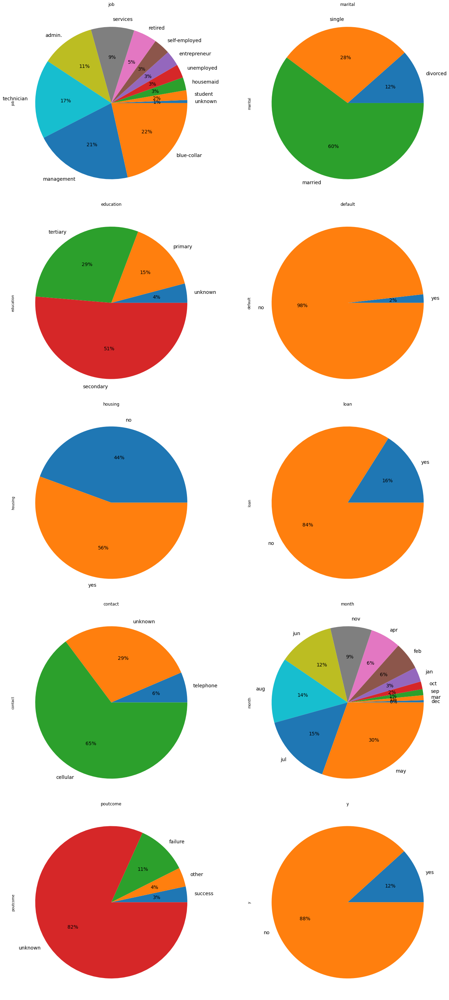

In [14]:
fig, axes = plt.subplots(5, 2, figsize=(20, 40))
axes = [ax for axes_row in axes for ax in axes_row]

for i, c in enumerate(data[cat_columns]):
    _ = data[c].value_counts()[::-1].plot(kind = 'pie', ax=axes[i], title=c, fontsize=14,autopct="%.0f%%")
    
_ = plt.tight_layout()


# Count plot for the categorical data

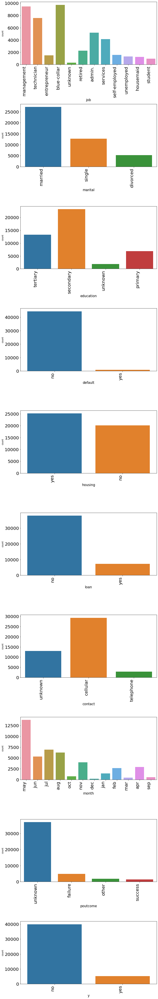

In [15]:
import matplotlib.pyplot as plt
import seaborn as sns
plt.figure(figsize=(10,100), facecolor='white')

plotnumber = 1

for column in data1:
    if plotnumber<=16 :
        ax = plt.subplot(16,1,plotnumber)
   
        sns.countplot(x=data1[column]);
        ax.set_xticklabels(ax.get_xticklabels(),rotation=90,ha='right')
        ax.tick_params(labelsize=20)
        plt.xlabel(column,fontsize=15)
        
    plotnumber+=1
plt.tight_layout()


#  **Univariate analysis of the numerical data**

# Histograms for the Numerical data 

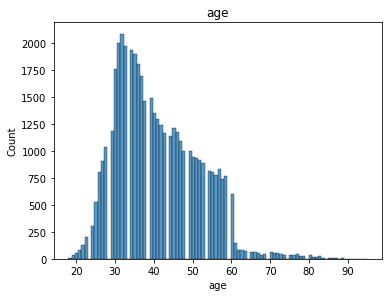

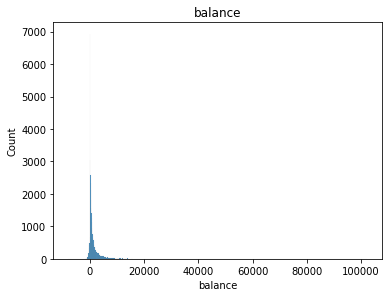

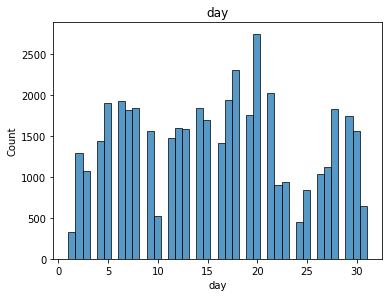

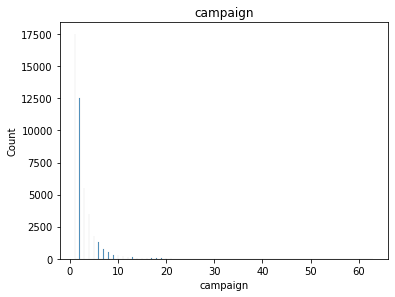

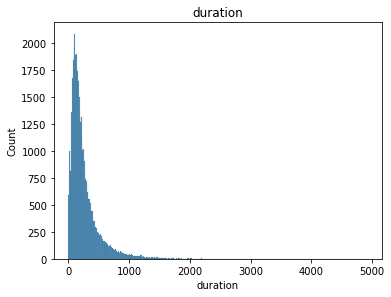

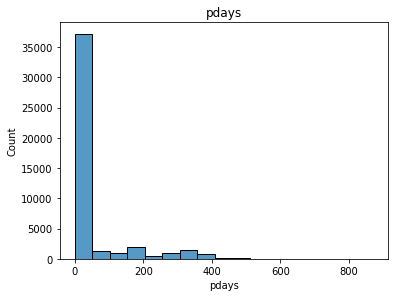

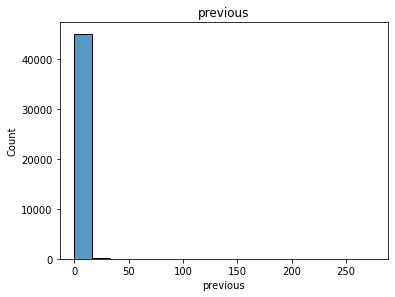

In [16]:
col=data[['age','balance','day','campaign','duration','pdays','previous']]
for i in col:
  n=1
  plt.figure(figsize=(20,20))
  plt.subplot(4,3,1)
  sns.histplot(data[i])
  plt.title(i)
  plt.show()
  n=n+1

# Distribution of the numerical columns

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


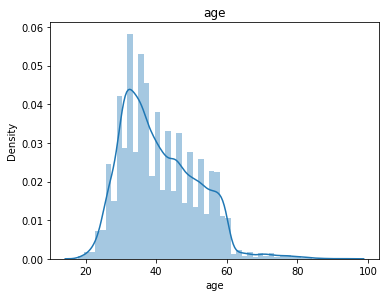

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


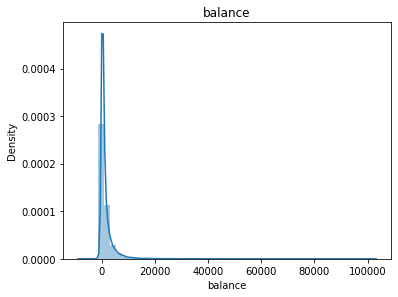

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


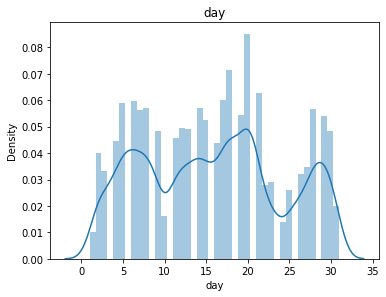

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


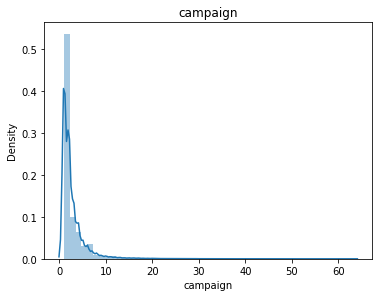

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


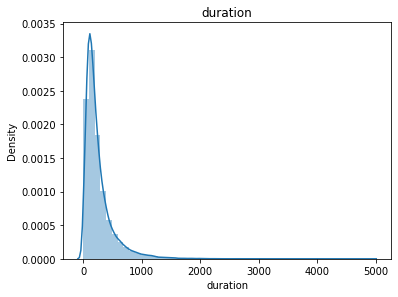

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


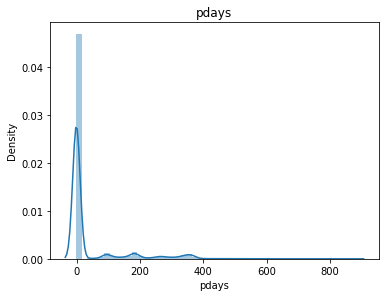

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


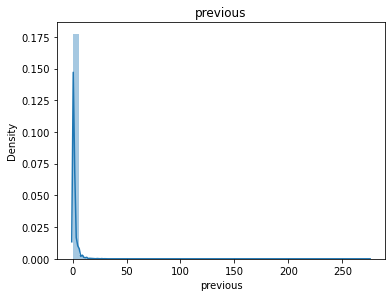

In [17]:
col=data[['age','balance','day','campaign','duration','pdays','previous']]
for i in col:
  n=1
  plt.figure(figsize=(20,20))
  plt.subplot(4,3,1)
  sns.distplot(data[i])
  plt.title(i)
  plt.show()
  n=n+1

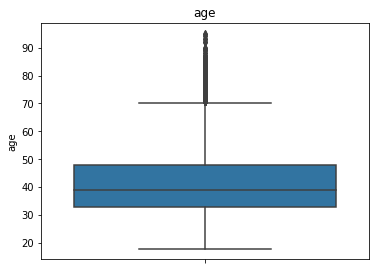

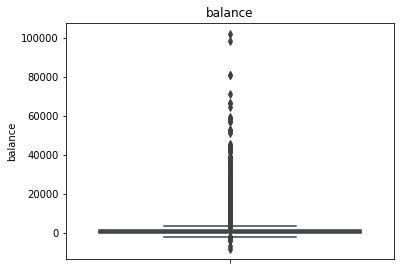

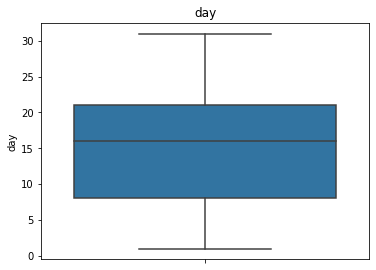

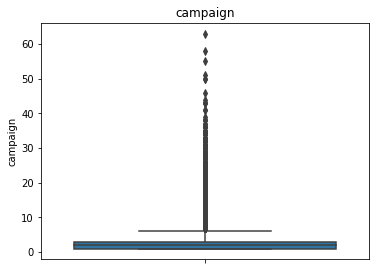

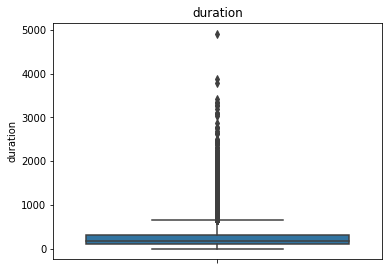

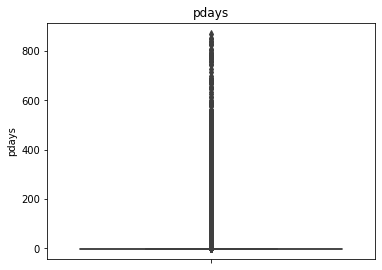

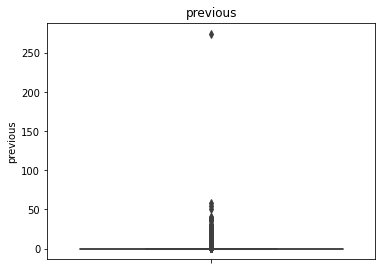

In [18]:
col=data[['age','balance','day','campaign','duration','pdays','previous']]
for i in col:
  n=1
  plt.figure(figsize=(20,20))
  plt.subplot(4,3,1)
  sns.boxplot(y=data[i])
  plt.title(i)
  plt.show()
  n=n+1

# **statistical summary of the data using dataprep library**

In [19]:
#install dataaprep
!pip install dataprep

     |████████████████████████████████| 1.8 MB 7.1 MB/s 
     |████████████████████████████████| 63 kB 3.1 MB/s 
     |████████████████████████████████| 76 kB 6.0 MB/s 
     |████████████████████████████████| 1.3 MB 66.7 MB/s 
     |████████████████████████████████| 366 kB 69.2 MB/s 
     |████████████████████████████████| 848 kB 61.9 MB/s 
     |████████████████████████████████| 719 kB 57.8 MB/s 
     |████████████████████████████████| 1.5 MB 59.4 MB/s 
     |████████████████████████████████| 50 kB 8.7 MB/s 
     |████████████████████████████████| 10.1 MB 9.1 MB/s 
     |████████████████████████████████| 294 kB 68.6 MB/s 
     |████████████████████████████████| 142 kB 69.8 MB/s 
     |████████████████████████████████| 118 kB 70.9 MB/s 
     |████████████████████████████████| 49 kB 8.4 MB/s 
     |████████████████████████████████| 743 kB 54.4 MB/s 
  Created wheel for metaphone: filename=Metaphone-0.6-py3-none-any.whl size=13919 sha256=76838c55930149465dbaa6a18f2444f81588faf2a1c14dd5a2

DataPrep Report
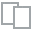
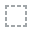
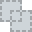
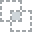
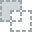
...
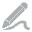
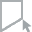
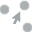
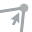
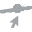

In [20]:
from dataprep.eda import create_report
create_report(data)

# Dataset Statistics
Number of Variables	17

Number of Rows	45211

Missing Cells	0

Missing Cells (%)	0.0%

Duplicate Rows	0

Duplicate Rows (%)	0.0%

Total Size in Memory	36.9 MB

Average Row Size in Memory	854.9 B

# **Insights of the data**

# Types of data

Variable Types:

Numerical	(7):-      ['age', 'balance', 'day', 'duration', 'campaign', 'pdays', 'previous']

Categorical	(*10*) :-['job', 'marital', 'education', 'default', 'housing', 'loan', 'contact', 'month', 'poutcome','y']


The information is written on the basis of above graphs and statistical summary.

**age:**

1. We have clients with all the ages (minimum age 18 to maximum age 95).
2. Mean(40.9362) and median(39) have very less diference.
3. age attribute does not have any missing values.
4. age is right skewed. As more number of data points are present on right tail. The boxplot, distplot and histogram is also showing the same.

**job:**

1. Job attribute shows the clients job information.
2. It also shows that there are some unknown values. It mean that they are not mentioned there job type.
3. Pie and Count plots shows that blue-collar, management, and technician clients have more subscriptions than the other clients.

**marital:**
1. mariatal attribute is shows the client marital information(married,single,divorced)
2. Pie and Count plots shows that married people are taking more subscriptions than the other clients

**Education:**

1.Education attribue shows the clients Education information-(['tertiary', 'secondary', 'unknown', 'primary'])

2.Pie and Count plots shows that secondary education type people are taking more subscription than the other clients.

**default:**
1. default attribute shows the client credit information-['yes','no'].
2. Pie and count plots shows that no credit clients are taking more subscription than the other clients.

**balance:**
1. Minimum	balance- (-8019), Maximum balance-	(102127)
2. Mean(1362.2721) and median(448) are different.
3. balance is right skewed. As more number of data points are present on right tail. The boxplot, distplot and histogram is also showing the same.
4. balance attribute does not have any missing values.

**housing:**
 1. housing attribute shows the client housing loan information.['yes','No']
 2. Pie and Count plots shows that housing loan ('yes') are taken more when compair to othere clients('no').

 **loan:**
 1. housing attribute shows the client personal  loan information.['yes','No']
 2. Pie and Count plots shows that personal loan ('no') are taken more when compair to other clients('yes').
 3. It quite opposite to the housing loan.

**contact:**
 1. contact attribute show the communication type-['unknown', 'cellular', 'telephone']
 2. Pie and count plot shows that clients are more contacted through the celluar type of communication when to other type.

**day:**
1. the starting day is 1 and the ending day is 31.
2. The mean is 15.80 and median is 16 
3. The highest frequency at 19.
4. It is normally distributed. The box plot, histogram and distribution plot also showing same. It doesnot have outilers and missing values.

**month:**
1. Month attribute is about the 12 months information.
2. pie and count plot shows that the May has the highest count when compair to other months.

**duration**
1. Duration is in seconds 
2. minimum duration is 0 sec and the maximum duration is 480 sec
3. The higest frequency of the duration  is at 0-250.
4. The mean is 258 and median is 180. there is more difference between mean and the median.

**campaign:**
1. They conducted 63 campaigns.
2. The higest frequency is in between 1-5 campaigns.
3. The campaign is distributed as right skewed.
4. mean is 2.7 and median is 2.
5. There is no missing values in campaigns.

**pdays:**
1. it is about the number of days that passed by after the client was last contacted from a previous campaign.
2. If pdays=-1 ,-1 means client was not previously contacted.
3. Hence 36954 clients were not contacted in previous campaigns.
4. only We have 5 clients that were contacted in previous campaign

**previous:**
1. It is about the number of contacts performed before this campaign and for this client.
2. They performed(0-275) times  of contacts for different clients.
3. The highest contacts are made at the 0th time(1st time) they contacted 3654.
4. The lowest contacts are made at the 
55(time)   1(contacts)
40   ''    1
35         1
58         1
51         1
41         1
32         1
275        1
**poutcome:**
1. poutcome attribute is about the previous outcome information['unknown', 'failure', 'other', 'success'].
2. pie and count plots shows that highest count is Unknown and lowest count is Success.

**y:**
1. y is the  target variable. It is about the clients subscribe the term desposite (yes or no).
2. pie and count plots shows that highest count is no and lowest count is yes.


# Bivariate analysis on the Total Subscription

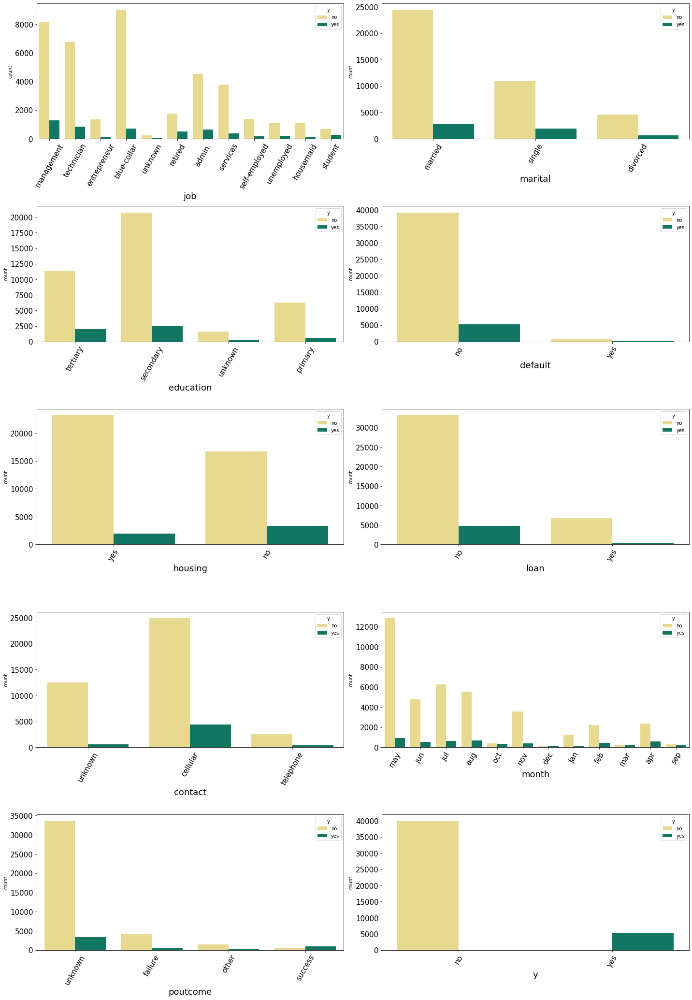

In [21]:
#bivariate analysis of categorical data with y
import matplotlib.pyplot as plt
import seaborn as sns
plotnumber = 1
plt.figure(figsize=(20,45), facecolor='white')
for column in data1:
    if plotnumber<=16 :
        ax = plt.subplot(8,2,plotnumber)
   
        sns.countplot(x=data1[column],hue=data['y'], palette=['#f7e382','#00876c']);
        
        ax.set_xticklabels(ax.get_xticklabels(),rotation=60,ha="center")
        plt.xlabel(column,fontsize=18,fontdict=None)
        ax.tick_params(labelsize=15)
        
    plotnumber+=1
plt.tight_layout()


# **Insights of bi virate analysis on the basis of count plot**

Job:
1. The higest count of  subscription(yes) is in management with comparision of others.
2. The highest count of not subscription (no) is in blue-collar with comparision of others.

Marital:
1. The Highest count of subcription(yes) is in marriage with comparision of others.
2. The highest count of not subscription (no) is in marriage with comparision of others.

Education:
1. The Highest count of subcription(yes) is Secondary with comparision of others.
2. The highest count of not subscription (no) is in Secondary with comparision of others.

default:
1. The Highest count of subcription(yes) is in no(default credit) with comparision of others.
2. The highest count of not subscription (no) is in no(default credit)  with comparision of others.

housing:
1. The Highest count of subcription(yes) is in no(housing loan) with comparision of others.
2. The highest count of not subscription (no) is in yes(housing loan) with comparision of others.

loan:
1. The Highest count of subcription(yes) is in no(personal loan) with comparision of others.
2. The highest count of not subscription (no) is in no(personal loan) with comparision of others.

contact:
1. The Highest count of subcription(yes) is in celluar with comparision of others.
2. The highest count of not subscription (no) is in yes celluar with comparision of others.

month:
1. The Highest count of subcription(yes) is in may month with comparision of others.
2. The highest count of not subscription (no) is in may month with comparision of others.

poutcome:
1. The Highest count of subcription(yes) is in unknown with comparision of others.
2. The highest count of not subscription (no) is in unknown with comparision of others.






#Bivariate analysis on the basis of the Percentage Subscription

In [22]:
total_count_in_each_group=[]
yes_count=[]
no_count=[]
title=[]
for i in data['job'].value_counts().index:
  df_job=pd.DataFrame()
  df_job=data[data['job']==i]
  title.append(i)
  total_count_in_each_group.append(df_job.shape[0])
  yes_count.append(df_job[df_job['y']=='yes'].count()['y'])
  no_count.append(df_job[df_job['y']=='no'].count()['y'])
df_jobs=pd.DataFrame()
df_jobs['Job Title']=title
df_jobs['Total']=total_count_in_each_group
df_jobs['Yes']=yes_count
df_jobs['No']=no_count
df_jobs

,Job Title,Total,Yes,No
0,blue-collar,9732,708,9024
1,management,9458,1301,8157
2,technician,7597,840,6757
3,admin.,5171,631,4540
4,services,4154,369,3785
5,retired,2264,516,1748
6,self-employed,1579,187,1392
7,entrepreneur,1487,123,1364
8,unemployed,1303,202,1101
9,housemaid,1240,109,1131


In [23]:
df_jobs_final=pd.DataFrame()
df_jobs_final['Job Title']=title
df_jobs_final['Percentage_yes']=(df_jobs['Yes']/df_jobs['Total'])*100
df_jobs_final['Percentage_no']=(df_jobs['No']/df_jobs['Total'])*100
df_jobs_final=df_jobs_final.sort_values('Percentage_yes',ascending=False)
df_jobs_final

,Job Title,Percentage_yes,Percentage_no
10,student,28.678038,71.321962
5,retired,22.791519,77.208481
8,unemployed,15.502686,84.497314
1,management,13.755551,86.244449
3,admin.,12.202669,87.797331
6,self-employed,11.842939,88.157061
11,unknown,11.805556,88.194444
2,technician,11.056996,88.943004
4,services,8.883004,91.116996
9,housemaid,8.790323,91.209677


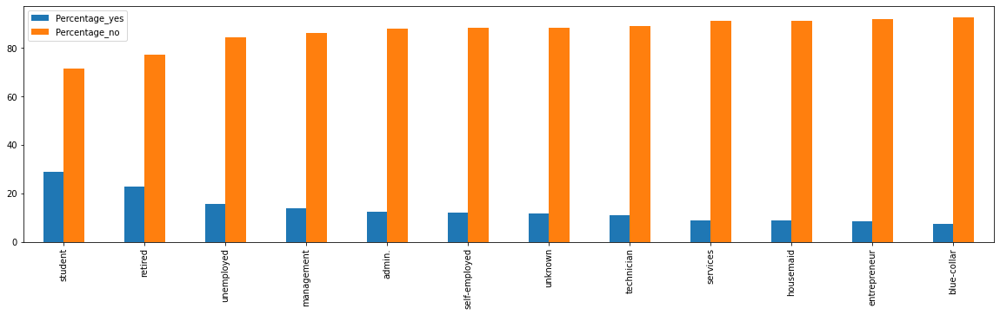

In [24]:
labels=df_jobs_final['Job Title'].tolist()
position=df_jobs_final['Job Title'].index
positions = np.arange(0,12,1)
df_jobs_final.plot(kind='bar',figsize=(20,5))
plt.xticks(positions, labels)
plt.show()

 The higest percentage of subscription in students and retire


In [25]:
total_count_in_each_group=[]
yes_count=[]
no_count=[]
title=[]
for i in data['marital'].value_counts().index:
  df_marital=pd.DataFrame()
  df_marital=data[data['marital']==i]
  title.append(i)
  total_count_in_each_group.append(df_marital.shape[0])
  yes_count.append(df_marital[df_marital['y']=='yes'].count()['y'])
  no_count.append(df_marital[df_marital['y']=='no'].count()['y'])
df_maritals=pd.DataFrame()
df_maritals['Marital Title']=title
df_maritals['Total']=total_count_in_each_group
df_maritals['Yes']=yes_count
df_maritals['No']=no_count
df_maritals



,Marital Title,Total,Yes,No
0,married,27214,2755,24459
1,single,12790,1912,10878
2,divorced,5207,622,4585


In [26]:
df_maritals_final=pd.DataFrame()
df_maritals_final['Marital Title']=title
df_maritals_final['Percentage_yes']=(df_maritals['Yes']/df_maritals['Total'])*100
df_maritals_final['Percentage_no']=(df_maritals['No']/df_maritals['Total'])*100
df_maritals_final=df_maritals_final.sort_values('Percentage_yes',ascending=False)
df_maritals_final


,Marital Title,Percentage_yes,Percentage_no
1,single,14.949179,85.050821
2,divorced,11.945458,88.054542
0,married,10.123466,89.876534


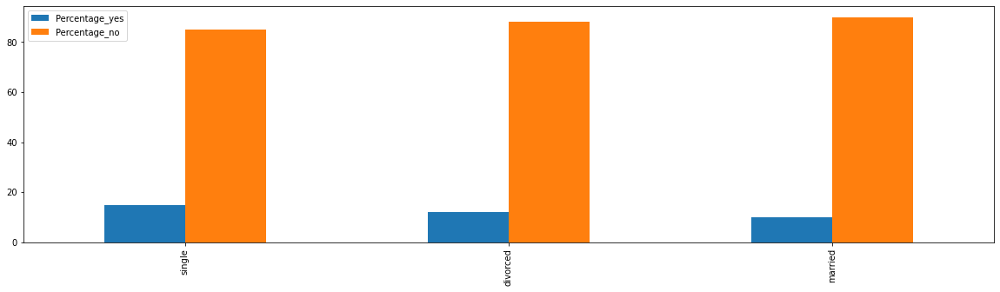

In [27]:
labels=df_maritals_final['Marital Title'].tolist()
position=df_maritals_final['Marital Title'].index
positions = np.arange(0,3,1)
df_maritals_final.plot(kind='bar',figsize=(20,5))
plt.xticks(positions, labels)
plt.show()



The higest percentage of subscription is in single.

In [28]:
total_count_in_each_group=[]
yes_count=[]
no_count=[]
title=[]
for i in data['education'].value_counts().index:
  df_education=pd.DataFrame()
  df_education=data[data['education']==i]
  title.append(i)
  total_count_in_each_group.append(df_education.shape[0])
  yes_count.append(df_education[df_education['y']=='yes'].count()['y'])
  no_count.append(df_education[df_education['y']=='no'].count()['y'])
df_educations=pd.DataFrame()
df_educations['Education Title']=title
df_educations['Total']=total_count_in_each_group
df_educations['Yes']=yes_count
df_educations['No']=no_count
df_educations



,Education Title,Total,Yes,No
0,secondary,23202,2450,20752
1,tertiary,13301,1996,11305
2,primary,6851,591,6260
3,unknown,1857,252,1605


In [29]:
df_educations_final=pd.DataFrame()
df_educations_final['Education Title']=title
df_educations_final['Percentage_yes']=(df_educations['Yes']/df_educations['Total'])*100
df_educations_final['Percentage_no']=(df_educations['No']/df_educations['Total'])*100
df_educations_final=df_educations_final.sort_values('Percentage_yes',ascending=False)
df_educations_final


,Education Title,Percentage_yes,Percentage_no
1,tertiary,15.006390,84.993610
3,unknown,13.570275,86.429725
0,secondary,10.559435,89.440565
2,primary,8.626478,91.373522


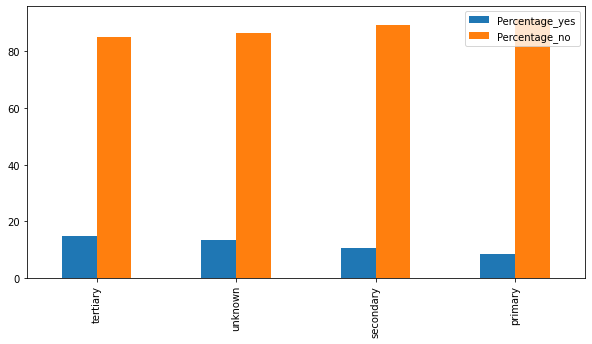

In [30]:
labels=df_educations_final['Education Title'].tolist()
position=df_educations_final['Education Title'].index
positions = np.arange(0,4,1)
df_educations_final.plot(kind='bar',figsize=(10,5))
plt.xticks(positions, labels)
plt.show()


The higest percentage of subscription is in tertiary

In [31]:
total_count_in_each_group=[]
yes_count=[]
no_count=[]
title=[]
for i in data['default'].value_counts().index:
  df_default=pd.DataFrame()
  df_default=data[data['default']==i]
  title.append(i)
  total_count_in_each_group.append(df_default.shape[0])
  yes_count.append(df_default[df_default['y']=='yes'].count()['y'])
  no_count.append(df_default[df_default['y']=='no'].count()['y'])
df_defaults=pd.DataFrame()
df_defaults['Default Title']=title
df_defaults['Total']=total_count_in_each_group
df_defaults['Yes']=yes_count
df_defaults['No']=no_count
df_defaults


,Default Title,Total,Yes,No
0,no,44396,5237,39159
1,yes,815,52,763


In [32]:
df_defaults_final=pd.DataFrame()
df_defaults_final['Default Title']=title
df_defaults_final['Percentage_yes']=(df_defaults['Yes']/df_defaults['Total'])*100
df_defaults_final['Percentage_no']=(df_defaults['No']/df_defaults['Total'])*100
df_defaults_final=df_defaults_final.sort_values('Percentage_yes',ascending=False)
df_defaults_final


,Default Title,Percentage_yes,Percentage_no
0,no,11.796108,88.203892
1,yes,6.380368,93.619632


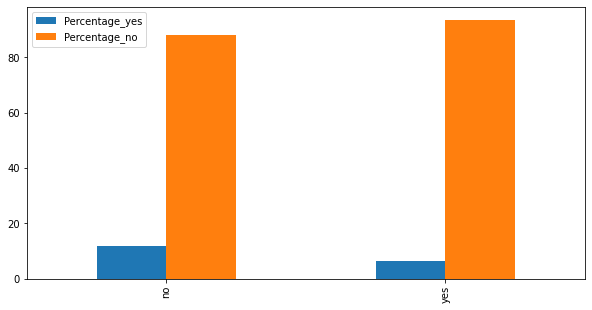

In [33]:
labels=df_defaults_final['Default Title'].tolist()
position=df_defaults_final['Default Title'].index
positions = np.arange(0,2,1)
df_defaults_final.plot(kind='bar',figsize=(10,5))
plt.xticks(positions, labels)
plt.show()


The higest percentage of subscription in no(default credit).



In [34]:
total_count_in_each_group=[]
yes_count=[]
no_count=[]
title=[]
for i in data['housing'].value_counts().index:
  df_housing=pd.DataFrame()
  df_housing=data[data['housing']==i]
  title.append(i)
  total_count_in_each_group.append(df_housing.shape[0])
  yes_count.append(df_housing[df_housing['y']=='yes'].count()['y'])
  no_count.append(df_housing[df_housing['y']=='no'].count()['y'])
df_housings=pd.DataFrame()
df_housings['Housing Title']=title
df_housings['Total']=total_count_in_each_group
df_housings['Yes']=yes_count
df_housings['No']=no_count
df_housings


,Housing Title,Total,Yes,No
0,yes,25130,1935,23195
1,no,20081,3354,16727


In [35]:
df_housings_final=pd.DataFrame()
df_housings_final['Housing Title']=title
df_housings_final['Percentage_yes']=(df_housings['Yes']/df_housings['Total'])*100
df_housings_final['Percentage_no']=(df_housings['No']/df_housings['Total'])*100
df_housings_final=df_housings_final.sort_values('Percentage_yes',ascending=False)
df_housings_final


,Housing Title,Percentage_yes,Percentage_no
1,no,16.702355,83.297645
0,yes,7.699960,92.300040


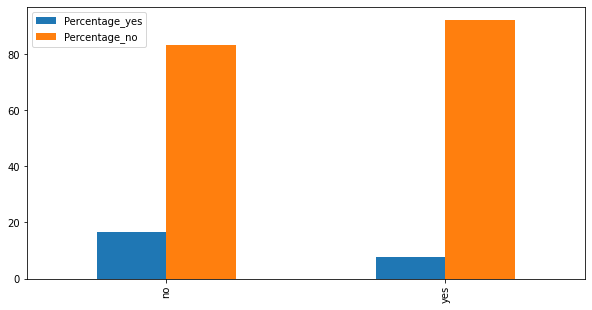

In [36]:
labels=df_housings_final['Housing Title'].tolist()
position=df_housings_final['Housing Title'].index
positions = np.arange(0,2,1)
df_housings_final.plot(kind='bar',figsize=(10,5))
plt.xticks(positions, labels)
plt.show()


The higest percentage of subscription in no (housing loan).



In [37]:
total_count_in_each_group=[]
yes_count=[]
no_count=[]
title=[]
for i in data['loan'].value_counts().index:
  df_loan=pd.DataFrame()
  df_loan=data[data['loan']==i]
  title.append(i)
  total_count_in_each_group.append(df_loan.shape[0])
  yes_count.append(df_loan[df_loan['y']=='yes'].count()['y'])
  no_count.append(df_loan[df_loan['y']=='no'].count()['y'])
df_loans=pd.DataFrame()
df_loans['Loan Title']=title
df_loans['Total']=total_count_in_each_group
df_loans['Yes']=yes_count
df_loans['No']=no_count
df_loans


,Loan Title,Total,Yes,No
0,no,37967,4805,33162
1,yes,7244,484,6760


In [38]:
df_loans_final=pd.DataFrame()
df_loans_final['Loan Title']=title
df_loans_final['Percentage_yes']=(df_loans['Yes']/df_loans['Total'])*100
df_loans_final['Percentage_no']=(df_loans['No']/df_loans['Total'])*100
df_loans_final=df_loans_final.sort_values('Percentage_yes',ascending=False)
df_loans_final


,Loan Title,Percentage_yes,Percentage_no
0,no,12.655727,87.344273
1,yes,6.681391,93.318609


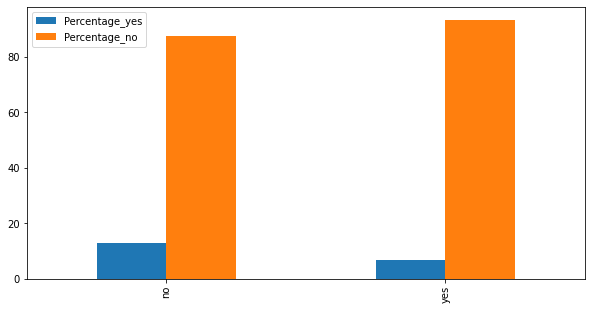

In [39]:
labels=df_loans_final['Loan Title'].tolist()
position=df_loans_final['Loan Title'].index
positions = np.arange(0,2,1)
df_loans_final.plot(kind='bar',figsize=(10,5))
plt.xticks(positions, labels)
plt.show()


The higest percentage of subscription in no (personal loan).



In [40]:
total_count_in_each_group=[]
yes_count=[]
no_count=[]
title=[]
for i in data['contact'].value_counts().index:
  df_contact=pd.DataFrame()
  df_contact=data[data['contact']==i]
  title.append(i)
  total_count_in_each_group.append(df_contact.shape[0])
  yes_count.append(df_contact[df_contact['y']=='yes'].count()['y'])
  no_count.append(df_contact[df_contact['y']=='no'].count()['y'])
df_contacts=pd.DataFrame()
df_contacts['Contact Title']=title
df_contacts['Total']=total_count_in_each_group
df_contacts['Yes']=yes_count
df_contacts['No']=no_count
df_contacts


,Contact Title,Total,Yes,No
0,cellular,29285,4369,24916
1,unknown,13020,530,12490
2,telephone,2906,390,2516


In [41]:
df_contacts_final=pd.DataFrame()
df_contacts_final['Contact Title']=title
df_contacts_final['Percentage_yes']=(df_contacts['Yes']/df_contacts['Total'])*100
df_contacts_final['Percentage_no']=(df_contacts['No']/df_contacts['Total'])*100
df_contacts_final=df_contacts_final.sort_values('Percentage_yes',ascending=False)
df_contacts_final


,Contact Title,Percentage_yes,Percentage_no
0,cellular,14.918900,85.081100
2,telephone,13.420509,86.579491
1,unknown,4.070661,95.929339


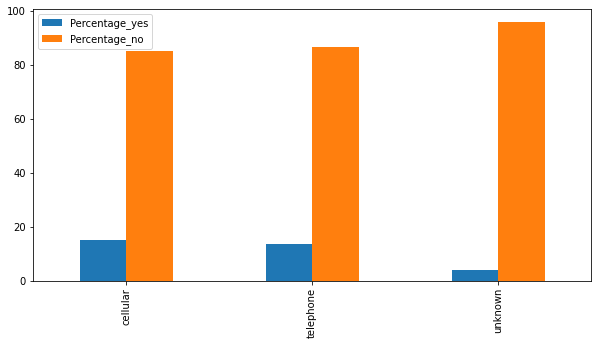

In [42]:
labels=df_contacts_final['Contact Title'].tolist()
position=df_contacts_final['Contact Title'].index
positions = np.arange(0,3,1)
df_contacts_final.plot(kind='bar',figsize=(10,5))
plt.xticks(positions, labels)
plt.show()



The higest percentage of subscription in cellular type contact.



In [43]:
total_count_in_each_group=[]
yes_count=[]
no_count=[]
title=[]
for i in data['month'].value_counts().index:
  df_month=pd.DataFrame()
  df_month=data[data['month']==i]
  title.append(i)
  total_count_in_each_group.append(df_month.shape[0])
  yes_count.append(df_month[df_month['y']=='yes'].count()['y'])
  no_count.append(df_month[df_month['y']=='no'].count()['y'])
df_months=pd.DataFrame()
df_months['Month Title']=title
df_months['Total']=total_count_in_each_group
df_months['Yes']=yes_count
df_months['No']=no_count
df_months


,Month Title,Total,Yes,No
0,may,13766,925,12841
1,jul,6895,627,6268
2,aug,6247,688,5559
3,jun,5341,546,4795
4,nov,3970,403,3567
5,apr,2932,577,2355
6,feb,2649,441,2208
7,jan,1403,142,1261
8,oct,738,323,415
9,sep,579,269,310


In [44]:
data['month'].value_counts()

may    13766
jul     6895
aug     6247
jun     5341
nov     3970
apr     2932
feb     2649
jan     1403
oct      738
sep      579
mar      477
dec      214
Name: month, dtype: int64

In [45]:
data.loc[data['month']=='jan','month']=1
data.loc[data['month']=='feb','month']=2
data.loc[data['month']=='mar','month']=3
data.loc[data['month']=='apr','month']=4
data.loc[data['month']=='may','month']=5
data.loc[data['month']=='jun','month']=6
data.loc[data['month']=='jul','month']=7
data.loc[data['month']=='aug','month']=8
data.loc[data['month']=='sep','month']=9
data.loc[data['month']=='oct','month']=10
data.loc[data['month']=='nov','month']=11
data.loc[data['month']=='dec','month']=12


In [46]:
dict1=dict(list(data.groupby(['month','y'])))
list1=[1,2,3,4,5,6,7,8,9,10,11,12]
no=[]
yes=[]
months=[]
for i in list1:
  months.append(i)
  for j in ['no','yes']:
    if(j=='no'):
      no.append(dict1[i,j].count()['y'])
    else:
      yes.append(dict1[i,j].count()['y'])

total_count_per_month=[]
dict2=dict(list(data.groupby(['month'])))
for i in list1:
  total_count_per_month.append(dict2[i].count()['y'])

      
print(months)
print(total_count_per_month)
print(yes)
print(no)

[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12]
[1403, 2649, 477, 2932, 13766, 5341, 6895, 6247, 579, 738, 3970, 214]
[142, 441, 248, 577, 925, 546, 627, 688, 269, 323, 403, 100]
[1261, 2208, 229, 2355, 12841, 4795, 6268, 5559, 310, 415, 3567, 114]


In [47]:
month_wise=pd.DataFrame()
month_wise['Months']=months
month_wise['Total ENteries per month']=total_count_per_month
month_wise['Count of Subscribed']=yes
month_wise['Count of Not Sub']=no
month_wise['Subscription Rate']=(month_wise['Count of Subscribed']/month_wise['Total ENteries per month'])*100
month_wise['Not Sub Rate']=(month_wise['Count of Not Sub']/month_wise['Total ENteries per month'])*100
month_wise=month_wise.sort_values("Subscription Rate",ascending=False)
month_wise

,Months,Total ENteries per month,Count of Subscribed,Count of Not Sub,Subscription Rate,Not Sub Rate
2,3,477,248,229,51.991614,48.008386
11,12,214,100,114,46.728972,53.271028
8,9,579,269,310,46.459413,53.540587
9,10,738,323,415,43.766938,56.233062
3,4,2932,577,2355,19.679400,80.320600
1,2,2649,441,2208,16.647792,83.352208
7,8,6247,688,5559,11.013286,88.986714
5,6,5341,546,4795,10.222805,89.777195
10,11,3970,403,3567,10.151134,89.848866
0,1,1403,142,1261,10.121169,89.878831


/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning
/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


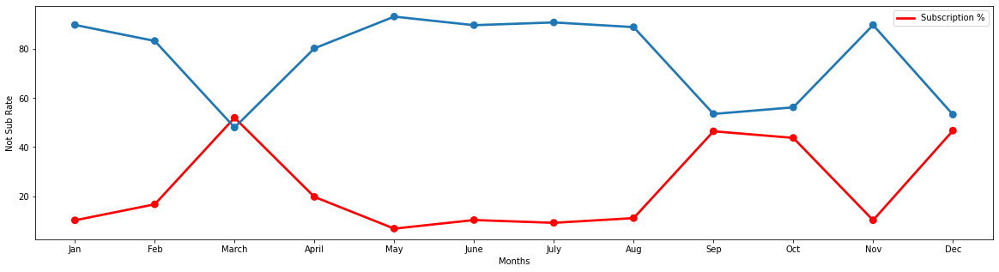

In [48]:
#month

plt.figure(figsize=(20,5))
labels=['Jan','Feb','March','April','May','June','July','Aug','Sep','Oct','Nov','Dec']
position=np.arange(0,12,1)
sns.pointplot(month_wise['Months'],month_wise['Subscription Rate'],color='Red')
sns.pointplot(month_wise['Months'],month_wise['Not Sub Rate'],)

plt.xticks(position,labels)
plt.legend(['Subscription %'])
plt.show()


The higest percentage of subscription in march and Dec month only.

In [49]:
total_count_in_each_group=[]
yes_count=[]
no_count=[]
title=[]
for i in data['poutcome'].value_counts().index:
  df_poutcome=pd.DataFrame()
  df_poutcome=data[data['poutcome']==i]
  title.append(i)
  total_count_in_each_group.append(df_poutcome.shape[0])
  yes_count.append(df_poutcome[df_poutcome['y']=='yes'].count()['y'])
  no_count.append(df_poutcome[df_poutcome['y']=='no'].count()['y'])
df_poutcomes=pd.DataFrame()
df_poutcomes['Poutcome Title']=title
df_poutcomes['Total']=total_count_in_each_group
df_poutcomes['Yes']=yes_count
df_poutcomes['No']=no_count
df_poutcomes


,Poutcome Title,Total,Yes,No
0,unknown,36959,3386,33573
1,failure,4901,618,4283
2,other,1840,307,1533
3,success,1511,978,533


In [50]:
df_poutcomes_final=pd.DataFrame()
df_poutcomes_final['Poutcome Title']=title
df_poutcomes_final['Percentage_yes']=(df_poutcomes['Yes']/df_poutcomes['Total'])*100
df_poutcomes_final['Percentage_no']=(df_poutcomes['No']/df_poutcomes['Total'])*100
df_poutcomes_final=df_poutcomes_final.sort_values('Percentage_yes',ascending=False)
df_poutcomes_final


,Poutcome Title,Percentage_yes,Percentage_no
3,success,64.725347,35.274653
2,other,16.684783,83.315217
1,failure,12.609671,87.390329
0,unknown,9.161503,90.838497


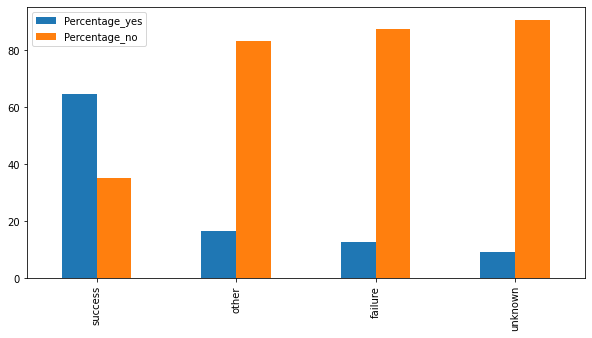

In [51]:

labels=df_poutcomes_final['Poutcome Title'].tolist()
position=df_poutcomes_final['Poutcome Title'].index
positions = np.arange(0,4,1)
df_poutcomes_final.plot(kind='bar',figsize=(10,5))
plt.xticks(positions, labels)
plt.show()


The higest percentage of  subscription is in success(poutcome) only

# **Bivariate analysis of numerical data**

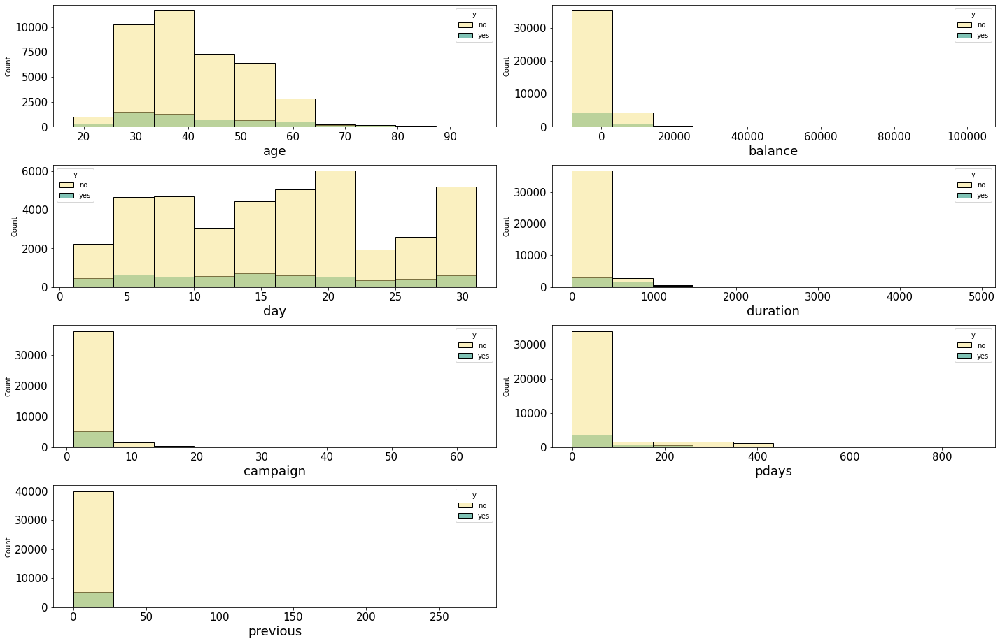

In [52]:
#bivariate analysis of numerical data with y
import matplotlib.pyplot as plt
import seaborn as sns
plt.figure(figsize=(20,25), facecolor='white')

plotnumber = 1

for column in data2:
    if plotnumber<=16 :
        ax = plt.subplot(8,2,plotnumber)
   
        sns.histplot(x=data2[column],hue=data['y'],multiple='layer',element='bars',bins=10, palette=['#f7e382','#00876c']);
        plt.xlabel(column,fontsize=8)
        plt.xlabel(column,fontsize=18,fontdict=None)
        ax.tick_params(labelsize=15)
    plotnumber+=1
plt.tight_layout()


In [53]:
a1=data[(data['age']>=18) & (data['age']<=28)]
a2=data[(data['age']>=29) & (data['age']<=39)]
a3=data[(data['age']>=40) & (data['age']<=50)]
a4=data[(data['age']>=51) & (data['age']<=60)]
a5=data[(data['age']>=61)]


In [54]:
total=[]
list1=[a1,a2,a3,a4,a5]
for i in list1:
  total.append(i.shape[0])
yes_count=[]
for i in list1:
  yes_count.append(i[i['y']=='yes'].count()['y'])

In [55]:
age_final=pd.DataFrame()
age_final['Age Groups']=['18-28','29-39','40-50','51-60','61+']
age_final['Total']=total
age_final['Yes Count']=yes_count
age_final['Percetage']=(age_final['Yes Count']/age_final['Total'])*100
age_final.sort_values(by='Percetage',ascending=False)

,Age Groups,Total,Yes Count,Percetage
4,61+,1188,502,42.255892
0,18-28,4088,757,18.517613
1,29-39,19274,2084,10.812494
3,51-60,8067,811,10.053304
2,40-50,12594,1135,9.012228


1)Age groups 18-28 and 61+ age are the two groups who have higher Term Deposit Subscription rate as compared to other age groups

2)Rate of subscription is very less for the age group 40-50



In [56]:
dict1=dict(list(data.groupby(['day','y'])))
list1=np.arange(1,32,1)
no=[]
yes=[]
days=[]
for i in list1:
  days.append(i)
  for j in ['no','yes']:
    if(j=='no'):
      no.append(dict1[i,j].count()['y'])
    else:
      yes.append(dict1[i,j].count()['y'])

total_count_per_day=[]
dict2=dict(list(data.groupby(['day'])))
for i in list1:
  total_count_per_day.append(dict2[i].count()['y'])


In [57]:
day_wise=pd.DataFrame()
day_wise['Day']=days
day_wise['Total ENteries per day']=total_count_per_day
day_wise['Count of Subscribed']=yes
day_wise['Count of Not Sub']=no
day_wise['Subscription Rate']=(day_wise['Count of Subscribed']/day_wise['Total ENteries per day'])*100
day_wise['Not Sub Rate']=(day_wise['Count of Not Sub']/day_wise['Total ENteries per day'])*100
day_wise=day_wise.sort_values('Subscription Rate',ascending=False)

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


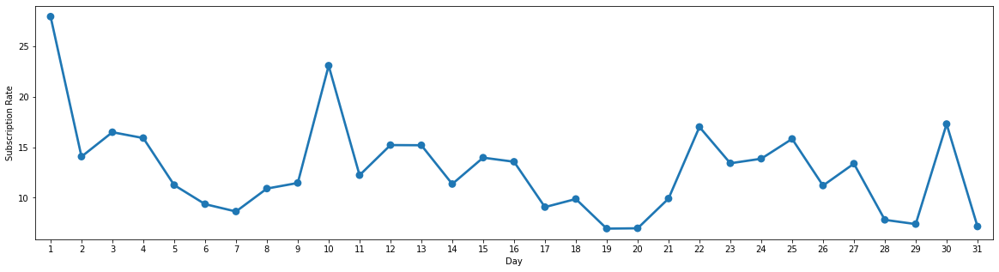

In [58]:
plt.figure(figsize=(20,5))
sns.pointplot(day_wise['Day'],day_wise['Subscription Rate'])
plt.show()

1. Day 1, 10 ,30 and 22 mark the high subscription rate.

2. Days 19 and 20 are having lowest subscription rate

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


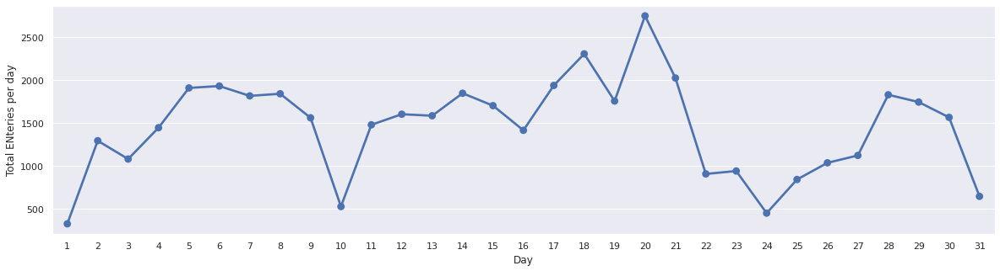

In [59]:
plt.figure(figsize=(20,5))
sns.set(style='darkgrid')
sns.pointplot(day_wise['Day'],day_wise['Total ENteries per day'])
plt.show()

1. Day 20 has the highest contacted members

2. Day 1 has lowest contacted members

In [60]:
total=[]
no=[]
yes=[]

total.append(data[(data['duration']<=500)].count()['duration'])
no.append(data[(data['duration']<=500) & (data['y']=='no')].count()['y'])
yes.append(data[(data['duration']<=500) & (data['y']=='yes')].count()['y'])


total.append(data[(data['duration']<=1000) & (data['duration']>500)].count()['duration'])
no.append(data[(data['duration']<=1000) & (data['duration']>500) & (data['y']=='no')].count()['y'])
yes.append(data[(data['duration']<=1000) & (data['duration']>500) & (data['y']=='yes')].count()['y'])

total.append(data[(data['duration']<=1500) & (data['duration']>1000)].count()['duration'])
no.append(data[(data['duration']<=1500) & (data['duration']>1000) & (data['y']=='no')].count()['y'])
yes.append(data[(data['duration']<=1500) & (data['duration']>1000) & (data['y']=='yes')].count()['y'])

total.append(data[(data['duration']<=2000) & (data['duration']>1500)].count()['duration'])
no.append(data[(data['duration']<=2000) & (data['duration']>1500) & (data['y']=='no')].count()['y'])
yes.append(data[(data['duration']<=2000) & (data['duration']>1500) & (data['y']=='yes')].count()['y'])

total.append(data[(data['duration']>2000)].count()['duration'])
no.append(data[(data['duration']>2000) & (data['y']=='no')].count()['y'])
yes.append(data[(data['duration']>2000) & (data['y']=='yes')].count()['y'])


duration=pd.DataFrame()
duration['Duration']=['Till 500','501-1000','1001-1500','1501-2000','2001+']
duration['total']=total
duration['Yes']=yes
duration['No']=no
duration['Yes percent']=(duration['Yes']/duration['total'])*100
duration.sort_values('Yes percent',ascending=False)


,Duration,total,Yes,No,Yes percent
3,1501-2000,168,108,60,64.285714
2,1001-1500,831,494,337,59.446450
4,2001+,59,30,29,50.847458
1,501-1000,4313,1645,2668,38.140505
0,Till 500,39840,3012,36828,7.560241


1)We have 39840 who have call duration less than 500 seconds.

Where the call duration is less(0-500seconds),we have very few clients subscribing.

2)Where the call duration is between 1500- 2000 seconds that is 15-30 mins we can see more number of clients subscribing to Term Deposit plan

3)We have 59 calls where the call duration is more than 2000 seconds

In [61]:
df_15=data[(data['campaign']<=15) ]
df_30=data[(data['campaign']>=16) & (data['campaign']<=30) ]
df_31=data[(data['campaign']>=31) ]


In [62]:
total_calls=[]
yes=[]
no=[]
for i in[df_15,df_30,df_31]:
  total_calls.append(i.count()['campaign'])
  yes.append(i[i['y']=='yes'].count()['y'])
  no.append(i[i['y']=='no'].count()['y'])



In [63]:
campaigns=pd.DataFrame()
campaigns['No.of call']=['Till 15','16- 30','30+ more']
campaigns['Total no of Calls']=total_calls
campaigns['Took Subscription']=yes
campaigns['No Subscription']=no
campaigns['Rate of Sub']=(campaigns['Took Subscription']/campaigns['Total no of Calls'])*100
campaigns

,No.of call,Total no of Calls,Took Subscription,No Subscription,Rate of Sub
0,Till 15,44681,5276,39405,11.808151
1,16- 30,471,12,459,2.547771
2,30+ more,59,1,58,1.694915


1)Calling between 1-15 has a good subscription rate as compared to calling more than 15 times

2)59 Customers we called more than 30 times,out of which only 1 client took the subscription

In [64]:
data[data['pdays']==-1]

,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous,poutcome,y
0,58,management,married,tertiary,no,2143,yes,no,unknown,5,5,261,1,-1,0,unknown,no
1,44,technician,single,secondary,no,29,yes,no,unknown,5,5,151,1,-1,0,unknown,no
2,33,entrepreneur,married,secondary,no,2,yes,yes,unknown,5,5,76,1,-1,0,unknown,no
3,47,blue-collar,married,unknown,no,1506,yes,no,unknown,5,5,92,1,-1,0,unknown,no
4,33,unknown,single,unknown,no,1,no,no,unknown,5,5,198,1,-1,0,unknown,no
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
45203,23,student,single,tertiary,no,113,no,no,cellular,17,11,266,1,-1,0,unknown,yes
45205,25,technician,single,secondary,no,505,no,yes,cellular,17,11,386,2,-1,0,unknown,yes
45206,51,technician,married,tertiary,no,825,no,no,cellular,17,11,977,3,-1,0,unknown,yes
45207,71,retired,divorced,primary,no,1729,no,no,cellular,17,11,456,2,-1,0,unknown,yes


If pdays=-1 ,-1 means client was not previously contacted.

Hence 36954 clients were not contacted in previous campaigns

In [65]:
data[(data['pdays']!=-1) & (data['poutcome']=='unknown')]

,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous,poutcome,y
40658,61,retired,married,tertiary,no,3140,yes,yes,cellular,6,8,975,4,98,1,unknown,yes
41821,39,management,married,tertiary,no,184,no,no,cellular,15,10,206,1,168,5,unknown,no
42042,26,admin.,single,secondary,no,338,no,no,cellular,29,10,209,1,188,2,unknown,yes
43978,30,technician,single,secondary,no,254,yes,yes,cellular,24,6,167,3,416,2,unknown,no
45021,37,management,married,secondary,no,209,no,no,cellular,14,10,183,3,528,7,unknown,no


We have 5 clients that were contacted in previous campaign but their outcome is mentioned as unknown

Multi variate analysis

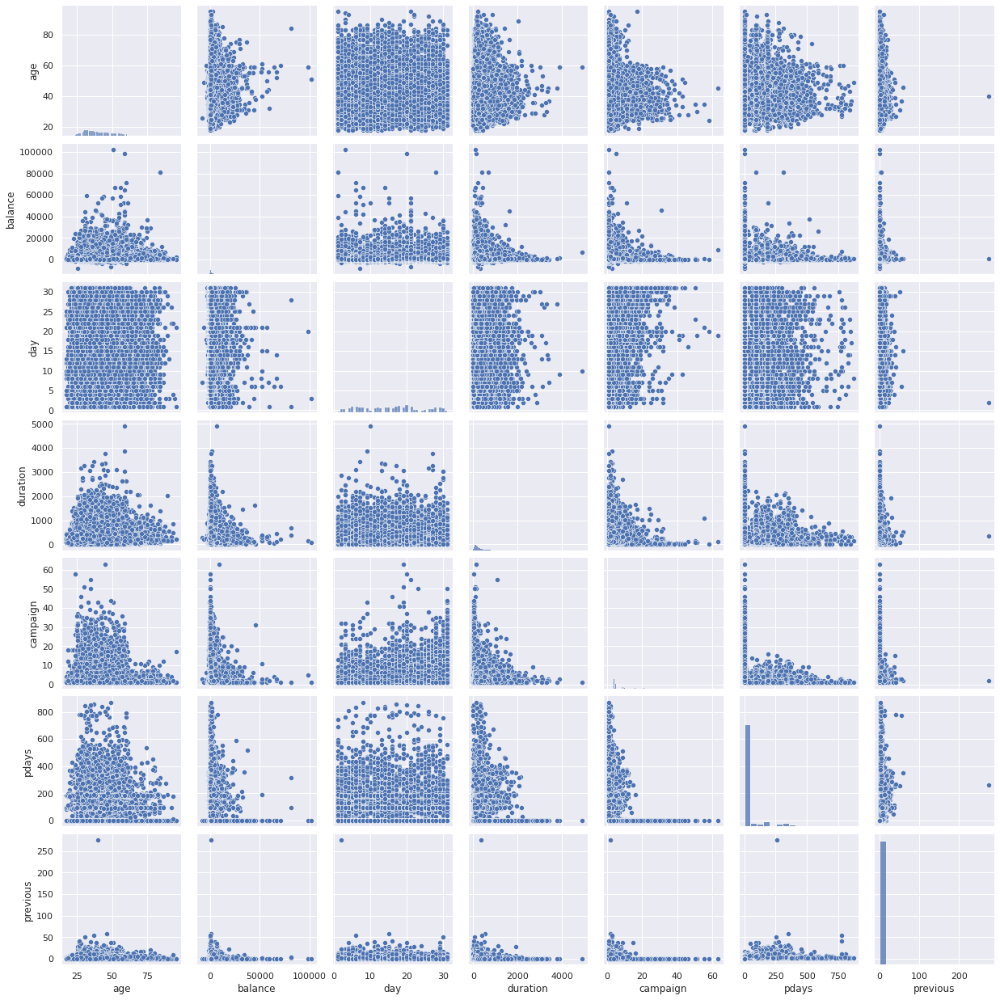

In [66]:
sns.pairplot(data2)

duration, campign and pdays are negatively correlated

# **Data Preprocessing**

In our data we have more outliers in many of the columns.

First of all when dealing with outliers the important point to note is what is percentage of outliers present in the column.If outliers more than 5% than there is no point of call them outliers,treatment is not required.

If percentage is less than 5%, check the distribution,if normally distributed use mean to do the imputation.If skewness is present use median for the same.

Also dropping should be last option to handle outliers.



In [67]:
#AGE
Q1=data['age'].quantile(q=0.25)
Q3=data['age'].quantile(q=0.75)
print('1st Quartile (Q1) is: ', Q1)
print('3st Quartile (Q3) is: ', Q3)

1st Quartile (Q1) is:  33.0
3st Quartile (Q3) is:  48.0


In [68]:
# IQR=Q3-Q1
#lower 1.5*IQR whisker i.e Q1-1.5*IQR
#upper 1.5*IQR whisker i.e Q3+1.5*IQR
L_outliers=Q1-1.5*(Q3-Q1)
U_outliers=Q3+1.5*(Q3-Q1)
print('Lower outliers in Ages: ', L_outliers)
print('Upper outliers in Ages: ', U_outliers)

Lower outliers in Ages:  10.5
Upper outliers in Ages:  70.5


In [69]:
print('Number of outliers in Age upper : ', data[data['age']>70.5]['age'].count())
print('Number of outliers in Age lower : ', data[data['age']<10.5]['age'].count())
print('% of Outlier in Age upper: ',round(data[data['age']>70.5]['age'].count()*100/len(data)), '%')
#len(data.loc[data['age']>70.5])/len(data['age'])*100

print('% of Outlier in Age lower: ',round(data[data['age']<10.5]['age'].count()*100/len(data)), '%')

Number of outliers in Age upper :  487
Number of outliers in Age lower :  0
% of Outlier in Age upper:  1 %
% of Outlier in Age lower:  0 %


In [70]:
data.loc[data['age']>70.5]

,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous,poutcome,y
29158,83,retired,married,primary,no,425,no,no,telephone,2,2,912,1,-1,0,unknown,no
29261,75,retired,divorced,primary,no,46,no,no,cellular,2,2,294,1,-1,0,unknown,no
29263,75,retired,married,primary,no,3324,no,no,cellular,2,2,149,1,-1,0,unknown,no
29322,83,retired,married,tertiary,no,6236,no,no,cellular,2,2,283,2,-1,0,unknown,no
29865,75,retired,divorced,primary,no,3881,yes,no,cellular,4,2,136,3,-1,0,unknown,yes
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
45163,71,retired,married,secondary,no,2064,no,no,cellular,9,11,379,2,92,3,failure,no
45191,75,retired,divorced,tertiary,no,3810,yes,no,cellular,16,11,262,1,183,1,failure,yes
45204,73,retired,married,secondary,no,2850,no,no,cellular,17,11,300,1,40,8,failure,yes
45207,71,retired,divorced,primary,no,1729,no,no,cellular,17,11,456,2,-1,0,unknown,yes


In [71]:
median = data.loc[data['age']<70.5, 'age'].median()
median

39.0

In [72]:
data.loc[data.age > 70.5, 'age'] =np.nan
data['age'].fillna(data['age'].median(), inplace=True)

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


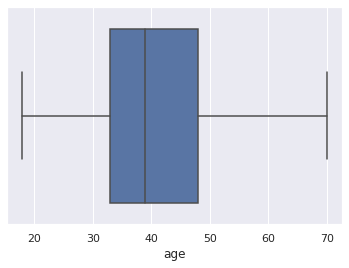

In [73]:
sns.boxplot(data['age'])

In [74]:
#Balance
B_Q1=data['balance'].quantile(q=0.25)
B_Q3=data['balance'].quantile(q=0.75)
print('1st Quartile (Q1) is: ', B_Q1)
print('3st Quartile (Q3) is: ', B_Q3)


1st Quartile (Q1) is:  72.0
3st Quartile (Q3) is:  1428.0


In [75]:
# IQR=Q3-Q1
#lower 1.5*IQR whisker i.e Q1-1.5*IQR
#upper 1.5*IQR whisker i.e Q3+1.5*IQR
L_outliers=B_Q1-1.5*(B_Q3-B_Q1)
U_outliers=B_Q3+1.5*(B_Q3-B_Q1)
print('Lower outliers in balance: ', L_outliers)
print('Upper outliers in balance: ', U_outliers)


Lower outliers in balance:  -1962.0
Upper outliers in balance:  3462.0


In [76]:
print('Number of outliers in Balance upper : ', data[data['balance']>3462.0]['balance'].count())
print('Number of outliers in Balance lower : ', data[data['balance']<(-1962.0)]['balance'].count())
print('% of Outlier in Balance upper: ',round(data[data['balance']>3462.0]['balance'].count()*100/len(data)), '%')
print('% of Outlier in Balance lower: ',round(data[data['balance']<(-1962.0)]['balance'].count()*100/len(data)), '%')


Number of outliers in Balance upper :  4712
Number of outliers in Balance lower :  17
% of Outlier in Balance upper:  10 %
% of Outlier in Balance lower:  0 %


In [77]:
#campaign
C_Q1=data['campaign'].quantile(q=0.25)
C_Q3=data['campaign'].quantile(q=0.75)
print('1st Quartile (Q1) is: ', C_Q1)
print('3st Quartile (Q3) is: ', C_Q3)


1st Quartile (Q1) is:  1.0
3st Quartile (Q3) is:  3.0


In [78]:
# IQR=Q3-Q1
#lower 1.5*IQR whisker i.e Q1-1.5*IQR
#upper 1.5*IQR whisker i.e Q3+1.5*IQR
L_outliers=(C_Q1)-1.5*(C_Q3-C_Q1)
U_outliers=(C_Q3)+1.5*(C_Q3-C_Q1)
print('Lower outliers in campaign: ', L_outliers)
print('Upper outliers in campaign: ', U_outliers)


Lower outliers in campaign:  -2.0
Upper outliers in campaign:  6.0


In [79]:
print('Number of outliers in Campaign upper : ', data[data['campaign']>6.0]['campaign'].count())
print('Number of outliers in Campaign lower : ', data[data['campaign']<(-2.0)]['campaign'].count())
print('% of Outlier in Campaign upper: ',round(data[data['campaign']>6.0]['campaign'].count()*100/len(data)), '%')
print('% of Outlier in Campaign lower: ',round(data[data['campaign']<(-2.0)]['campaign'].count()*100/len(data)), '%')


Number of outliers in Campaign upper :  3064
Number of outliers in Campaign lower :  0
% of Outlier in Campaign upper:  7 %
% of Outlier in Campaign lower:  0 %


In [80]:
Median = data.loc[data['campaign']<6, 'campaign'].median()
Median

2.0

In [81]:
data.loc[data.campaign > 6, 'campaign'] =np.nan
data['campaign'].fillna(data['campaign'].median(), inplace=True)

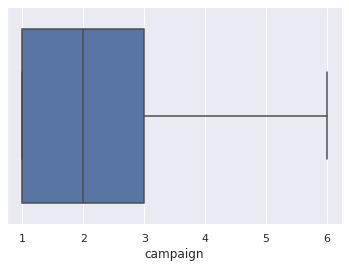

In [82]:
sns.boxplot(x=data['campaign'])

In [83]:
#Duration
DU_Q1=data['duration'].quantile(q=0.25)
DU_Q3=data['duration'].quantile(q=0.75)
print('1st Quartile (Q1) is: ', DU_Q1)
print('3st Quartile (Q3) is: ', DU_Q3)



1st Quartile (Q1) is:  103.0
3st Quartile (Q3) is:  319.0


In [84]:
# IQR=Q3-Q1
#lower 1.5*IQR whisker i.e Q1-1.5*IQR
#upper 1.5*IQR whisker i.e Q3+1.5*IQR
L_outliers=(DU_Q1)-1.5*(DU_Q3-DU_Q1)
U_outliers=(DU_Q3)+1.5*(DU_Q3-DU_Q1)
print('Lower outliers in campaign: ', L_outliers)
print('Upper outliers in campaign: ', U_outliers)


Lower outliers in campaign:  -221.0
Upper outliers in campaign:  643.0


In [85]:
print('Number of outliers in Duration upper : ', data[data['duration']>643.0]['duration'].count())
print('Number of outliers in Duration lower : ', data[data['duration']<(-221.0)]['duration'].count())
print('% of Outlier in Duration upper: ',round(data[data['duration']>643.0]['duration'].count()*100/len(data)), '%')
print('% of Outlier in Duration lower: ',round(data[data['duration']<(-221.0)]['duration'].count()*100/len(data)), '%')


Number of outliers in Duration upper :  3235
Number of outliers in Duration lower :  0
% of Outlier in Duration upper:  7 %
% of Outlier in Duration lower:  0 %


In [86]:
#pdays
PD_Q1=data['pdays'].quantile(q=0.25)
PD_Q3=data['pdays'].quantile(q=0.75)
print('1st Quartile (Q1) is: ', PD_Q1)
print('3st Quartile (Q3) is: ', PD_Q3)


1st Quartile (Q1) is:  -1.0
3st Quartile (Q3) is:  -1.0


In [87]:
# IQR=Q3-Q1
#lower 1.5*IQR whisker i.e Q1-1.5*IQR
#upper 1.5*IQR whisker i.e Q3+1.5*IQR
L_outliers=(PD_Q1)-1.5*(PD_Q3-PD_Q1)
U_outliers=(PD_Q3)+1.5*(PD_Q3-PD_Q1)
print('Lower outliers in pays: ', L_outliers)
print('Upper outliers in pdays: ', U_outliers)


Lower outliers in pays:  -1.0
Upper outliers in pdays:  -1.0


In [88]:
print('Number of outliers in Pdays upper : ', data[data['pdays']>(-1.0)]['pdays'].count())
print('Number of outliers in Pdays lower : ', data[data['pdays']<(-1.0)]['pdays'].count())
print('% of Outlier in Pdays upper: ',round(data[data['pdays']>(-1.0)]['pdays'].count()*100/len(data)), '%')
print('% of Outlier in Pdays lower: ',round(data[data['pdays']<(-1.0)]['pdays'].count()*100/len(data)), '%')



Number of outliers in Pdays upper :  8257
Number of outliers in Pdays lower :  0
% of Outlier in Pdays upper:  18 %
% of Outlier in Pdays lower:  0 %


In [89]:
#Previous
PR_Q1=data['previous'].quantile(q=0.25)
PR_Q3=data['previous'].quantile(q=0.75)
print('1st Quartile (Q1) is: ', PR_Q1)
print('3st Quartile (Q3) is: ', PR_Q3)


1st Quartile (Q1) is:  0.0
3st Quartile (Q3) is:  0.0


In [90]:
# IQR=Q3-Q1
#lower 1.5*IQR whisker i.e Q1-1.5*IQR
#upper 1.5*IQR whisker i.e Q3+1.5*IQR
L_outliers=(PR_Q1)-1.5*(PR_Q3-PR_Q1)
U_outliers=(PR_Q3)+1.5*(PR_Q3-PR_Q1)
print('Lower outliers in campaign: ', L_outliers)
print('Upper outliers in campaign: ', U_outliers)


Lower outliers in campaign:  0.0
Upper outliers in campaign:  0.0


In [91]:
print('Number of outliers in Previous upper : ', data[data['previous']>(-1.0)]['previous'].count())
print('Number of outliers in Previous lower : ', data[data['previous']<(-1.0)]['previous'].count())
print('% of Outlier in Previous upper: ',round(data[data['previous']>(-1.0)]['previous'].count()*100/len(data)), '%')
print('% of Outlier in Previous lower: ',round(data[data['previous']<(-1.0)]['previous'].count()*100/len(data)), '%')


Number of outliers in Previous upper :  45211
Number of outliers in Previous lower :  0
% of Outlier in Previous upper:  100 %
% of Outlier in Previous lower:  0 %


# **Converting categorical data into numerical data**

In [92]:
#copying 
df=data.copy()

In [93]:
df.isnull().sum()

age          0
job          0
marital      0
education    0
default      0
balance      0
housing      0
loan         0
contact      0
day          0
month        0
duration     0
campaign     0
pdays        0
previous     0
poutcome     0
y            0
dtype: int64

In [94]:
#following columns are replace the with number
df['marital'].replace(['married', 'single', 'divorced'],[2,1,0],inplace=True)
df['education'].replace(['tertiary', 'secondary', 'unknown', 'primary'],[3,2,0,1],inplace=True)
df['contact'].replace(['unknown', 'cellular', 'telephone'],[0,1,2],inplace=True)
df['month'].replace(['may', 'jun', 'jul', 'aug', 'oct', 'nov', 'dec', 'jan', 'feb',
       'mar', 'apr', 'sep'],[5,6,7,8,10,11,12,1,2,3,4,9],inplace=True)
df['poutcome'].replace(['unknown', 'failure', 'other', 'success'],[0,2,3,1],inplace=True)

In [95]:
df

,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous,poutcome,y
0,58.0,management,2,3,no,2143,yes,no,0,5,5,261,1.0,-1,0,0,no
1,44.0,technician,1,2,no,29,yes,no,0,5,5,151,1.0,-1,0,0,no
2,33.0,entrepreneur,2,2,no,2,yes,yes,0,5,5,76,1.0,-1,0,0,no
3,47.0,blue-collar,2,0,no,1506,yes,no,0,5,5,92,1.0,-1,0,0,no
4,33.0,unknown,1,0,no,1,no,no,0,5,5,198,1.0,-1,0,0,no
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
45206,51.0,technician,2,3,no,825,no,no,1,17,11,977,3.0,-1,0,0,yes
45207,39.0,retired,0,1,no,1729,no,no,1,17,11,456,2.0,-1,0,0,yes
45208,39.0,retired,2,2,no,5715,no,no,1,17,11,1127,5.0,184,3,1,yes
45209,57.0,blue-collar,2,2,no,668,no,no,2,17,11,508,4.0,-1,0,0,no


In [96]:
# Import label encoder
from sklearn import preprocessing
# label_encoder object knows how to understand word labels.
label_encoder = preprocessing.LabelEncoder()
  
df['job']= label_encoder.fit_transform(df['job'])
df['default']= label_encoder.fit_transform(df['default'])
df['housing']= label_encoder.fit_transform(df['housing'])
df['loan']= label_encoder.fit_transform(df['loan'])
df['y']= label_encoder.fit_transform(df['y'])

In [97]:
df

,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous,poutcome,y
0,58.0,4,2,3,0,2143,1,0,0,5,5,261,1.0,-1,0,0,0
1,44.0,9,1,2,0,29,1,0,0,5,5,151,1.0,-1,0,0,0
2,33.0,2,2,2,0,2,1,1,0,5,5,76,1.0,-1,0,0,0
3,47.0,1,2,0,0,1506,1,0,0,5,5,92,1.0,-1,0,0,0
4,33.0,11,1,0,0,1,0,0,0,5,5,198,1.0,-1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
45206,51.0,9,2,3,0,825,0,0,1,17,11,977,3.0,-1,0,0,1
45207,39.0,5,0,1,0,1729,0,0,1,17,11,456,2.0,-1,0,0,1
45208,39.0,5,2,2,0,5715,0,0,1,17,11,1127,5.0,184,3,1,1
45209,57.0,1,2,2,0,668,0,0,2,17,11,508,4.0,-1,0,0,0


# **Feature selection:**

In [98]:
cor=df.corr()
cor

,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous,poutcome,y
age,1.000000,-0.031163,0.133709,-0.156110,-0.014103,0.083635,-0.154465,0.000582,0.047014,-0.006885,0.090776,-0.016606,0.035431,-0.032723,-0.009887,-0.026727,-0.015297
job,-0.031163,1.000000,-0.071573,0.135898,-0.006853,0.018232,-0.125363,-0.033004,0.065299,0.022856,0.043142,0.004744,0.009616,-0.024455,-0.000911,-0.008167,0.040438
marital,0.133709,-0.071573,1.000000,-0.091853,-0.018404,0.028172,0.011671,0.018526,0.014290,0.005217,0.044321,-0.018834,0.035791,-0.020832,-0.006876,-0.018829,-0.043846
education,-0.156110,0.135898,-0.091853,1.000000,-0.009035,0.050572,-0.038689,0.004307,0.073425,0.021661,0.067935,0.002554,0.004996,0.007092,0.025295,0.027547,0.051341
default,-0.014103,-0.006853,-0.018404,-0.009035,1.000000,-0.066745,-0.006025,0.077234,-0.024095,0.009424,0.014989,-0.010021,0.008015,-0.029979,-0.018329,-0.034993,-0.022419
balance,0.083635,0.018232,0.028172,0.050572,-0.066745,1.000000,-0.068768,-0.084350,0.047701,0.004503,0.094605,0.021560,-0.015502,0.003435,0.016674,0.022465,0.052838
housing,-0.154465,-0.125363,0.011671,-0.038689,-0.006025,-0.068768,1.000000,0.041323,-0.207722,-0.027982,-0.173887,0.005075,-0.031606,0.124178,0.037076,0.088209,-0.139173
loan,0.000582,-0.033004,0.018526,0.004307,0.077234,-0.084350,0.041323,1.000000,0.000058,0.011370,0.021638,-0.012412,-0.000501,-0.022754,-0.011043,-0.019685,-0.068185
contact,0.047014,0.065299,0.014290,0.073425,-0.024095,0.047701,-0.207722,0.000058,1.000000,0.038643,0.167103,0.001494,0.040151,0.210651,0.139518,0.238209,0.130590
day,-0.006885,0.022856,0.005217,0.021661,0.009424,0.004503,-0.027982,0.011370,0.038643,1.000000,0.101989,-0.030206,0.091093,-0.093044,-0.051710,-0.081224,-0.028348


Text(0.5, 1.0, 'Correlation between attributes')

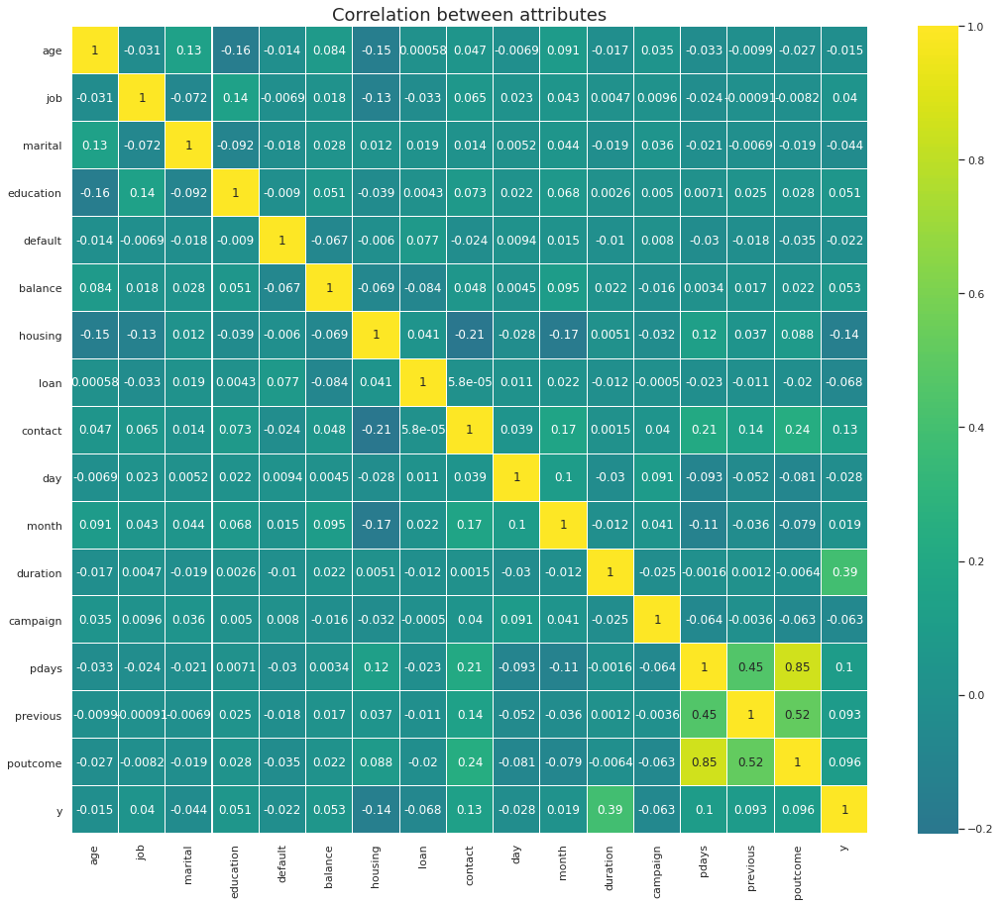

In [99]:
fig,ax=plt.subplots(figsize=(18,15))
sns.heatmap(cor,cmap='viridis',annot=True, linewidths=0.01, center=0)
plt.title('Correlation between attributes',fontsize=18)

pdays and previous are little correlated with each other'.

previous and poutcome are little correlated with eachother.' 

In [100]:
data.isnull().sum()

age          0
job          0
marital      0
education    0
default      0
balance      0
housing      0
loan         0
contact      0
day          0
month        0
duration     0
campaign     0
pdays        0
previous     0
poutcome     0
y            0
dtype: int64

# **Modeling Buliding**

In [101]:
df

,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous,poutcome,y
0,58.0,4,2,3,0,2143,1,0,0,5,5,261,1.0,-1,0,0,0
1,44.0,9,1,2,0,29,1,0,0,5,5,151,1.0,-1,0,0,0
2,33.0,2,2,2,0,2,1,1,0,5,5,76,1.0,-1,0,0,0
3,47.0,1,2,0,0,1506,1,0,0,5,5,92,1.0,-1,0,0,0
4,33.0,11,1,0,0,1,0,0,0,5,5,198,1.0,-1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
45206,51.0,9,2,3,0,825,0,0,1,17,11,977,3.0,-1,0,0,1
45207,39.0,5,0,1,0,1729,0,0,1,17,11,456,2.0,-1,0,0,1
45208,39.0,5,2,2,0,5715,0,0,1,17,11,1127,5.0,184,3,1,1
45209,57.0,1,2,2,0,668,0,0,2,17,11,508,4.0,-1,0,0,0


# **Logistic Regression**

In [102]:
X=df.drop(columns=['y'])
Y=df['y']

In [103]:
Y.value_counts()

0    39922
1     5289
Name: y, dtype: int64

Here target varible is totally imbalance.

# **Model Buliding For imbalance data**





In [104]:
#import module
from sklearn.preprocessing import MinMaxScaler
#Scaler Features
Scaler=MinMaxScaler()


In [105]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.20, random_state=42, stratify=Y)

In [106]:
X_train1= Scaler.fit_transform(X_train)
X_test1= Scaler.transform(X_test)

In [107]:
X_train1.shape,X_test1.shape

((36168, 16), (9043, 16))

In [108]:
#model Creation
from sklearn.linear_model import LogisticRegression
log_reg = LogisticRegression()
log_reg.fit(X_train1,y_train)
y_pred=log_reg.predict(X_test1)
y_pred

array([0, 0, 0, ..., 0, 0, 0])

In [109]:
## calculating accuracy
from sklearn.metrics import accuracy_score,auc, confusion_matrix,precision_score,recall_score
accuracy = accuracy_score(y_test,y_pred)
accuracy

0.8905230565077961

In [110]:
## Training score
y_train_predict=log_reg.predict(X_train1)
acc_train=accuracy_score(y_train,y_train_predict)
acc_train

0.890538597655386

In [111]:
from sklearn.metrics import classification_report
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.90      0.98      0.94      7985
           1       0.60      0.19      0.29      1058

    accuracy                           0.89      9043
   macro avg       0.75      0.59      0.61      9043
weighted avg       0.87      0.89      0.86      9043



# **KNN**

In [112]:
from sklearn.neighbors import KNeighborsClassifier
## taking optimal k how many clusters to create
error_rate = []
# Will take some time
for i in range(1,30):
    knn = KNeighborsClassifier(n_neighbors=i)
    knn.fit(X_train1,y_train)
    pred_knn = knn.predict(X_test1)
    error_rate.append(np.mean(pred_knn != y_test))

Text(0, 0.5, 'Error Rate')

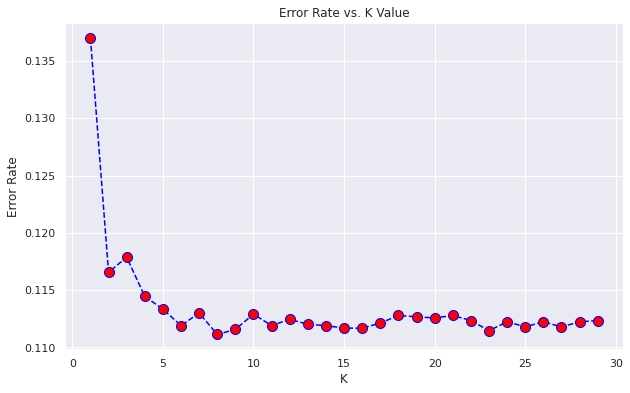

In [113]:
plt.figure(figsize=(10,6))
plt.plot(range(1,30),error_rate,color='blue', linestyle='dashed', marker='o',markerfacecolor='red', markersize=10)
plt.title('Error Rate vs. K Value')
plt.xlabel('K')
plt.ylabel('Error Rate')

In [114]:
# let's fit the data into kNN model and see how well it performs:
knn = KNeighborsClassifier(n_neighbors=10)
knn.fit(X_train1,y_train)

KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='minkowski',
                     metric_params=None, n_jobs=None, n_neighbors=10, p=2,
                     weights='uniform')

In [115]:
y_pred = knn.predict(X_test1)
y_pred.shape

(9043,)

In [116]:
#test accuracy
from sklearn.metrics import accuracy_score, confusion_matrix,classification_report
print("The accuracy score is : ", accuracy_score(y_test,y_pred))

The accuracy score is :  0.8870949906004645


In [117]:
## Training score
y_train_predict=knn.predict(X_train1)
acc_train=accuracy_score(y_train,y_train_predict)
acc_train

0.8950453439504534

In [118]:
print(classification_report(y_test,y_pred))

              precision    recall  f1-score   support

           0       0.89      0.99      0.94      7985
           1       0.60      0.11      0.18      1058

    accuracy                           0.89      9043
   macro avg       0.75      0.55      0.56      9043
weighted avg       0.86      0.89      0.85      9043



# **Decision Tree**

In [119]:
from sklearn.tree import DecisionTreeClassifier
dt=DecisionTreeClassifier()
dt.fit(X_train1,y_train)
y_pred_dt=dt.predict(X_test1)

In [120]:
## test acc
test_acc=accuracy_score(y_test,y_pred_dt)
test_acc

0.8755943823952228

In [121]:
## Evalauting the model
from sklearn.metrics import accuracy_score,classification_report,f1_score
## Training score
y_train_predict=dt.predict(X_train1)
acc_train=accuracy_score(y_train,y_train_predict)
acc_train

1.0

In [122]:
print(classification_report(y_test,y_pred_dt))

              precision    recall  f1-score   support

           0       0.93      0.93      0.93      7985
           1       0.47      0.49      0.48      1058

    accuracy                           0.88      9043
   macro avg       0.70      0.71      0.70      9043
weighted avg       0.88      0.88      0.88      9043



In the above we performed model buliding with different algorithms, there we observe that Recall value is very low. why because our target variable is highly imbalance nature. That's why we are moving to make the balanced target variable with the help of SMOTE() at below.

# **Model Buliding For Balaced data with SMOTE()**

In [123]:
from imblearn.over_sampling import SMOTE
smote = SMOTE() ## object creation

/usr/local/lib/python3.7/dist-packages/sklearn/externals/six.py:31: FutureWarning: The module is deprecated in version 0.21 and will be removed in version 0.23 since we've dropped support for Python 2.7. Please rely on the official version of six (https://pypi.org/project/six/).
  "(https://pypi.org/project/six/).", FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:144: FutureWarning: The sklearn.neighbors.base module is  deprecated in version 0.22 and will be removed in version 0.24. The corresponding classes / functions should instead be imported from sklearn.neighbors. Anything that cannot be imported from sklearn.neighbors is now part of the private API.
  warnings.warn(message, FutureWarning)


In [124]:
X_train_smote, y_train_smote = smote.fit_resample(X,Y)

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function safe_indexing is deprecated; safe_indexing is deprecated in version 0.22 and will be removed in version 0.24.
  warnings.warn(msg, category=FutureWarning)


In [125]:
from collections import Counter
print("Actual Classes",Counter(Y))
print("SMOTE Classes",Counter(y_train_smote))

Actual Classes Counter({0: 39922, 1: 5289})
SMOTE Classes Counter({0: 39922, 1: 39922})


In [126]:
from sklearn.model_selection import train_test_split

In [127]:
X_train2, X_test2, y_train2, y_test2 = train_test_split(X_train_smote, y_train_smote, test_size=0.20, random_state=42,stratify=y_train_smote)

In [128]:
#import module
from sklearn.preprocessing import MinMaxScaler
#Scaler Features
Scaler1=MinMaxScaler()

In [129]:
X_train3= Scaler.fit_transform(X_train2)
X_test3= Scaler.transform(X_test2)

In [130]:
X_train3.shape, X_test3.shape

((63875, 16), (15969, 16))

In [131]:
#y_train2.value_counts(), y_test2.value_counts()
from collections import Counter
print("Actual Classes",Counter(Y))
print("SMOTE Classes",Counter(y_train_smote))

Actual Classes Counter({0: 39922, 1: 5289})
SMOTE Classes Counter({0: 39922, 1: 39922})


In [132]:
#model Creation
from sklearn.linear_model import LogisticRegression
log_reg = LogisticRegression(max_iter=1000)
log_reg.fit(X_train3,y_train2)
lr_y_pred=log_reg.predict(X_test3)
lr_y_pred

array([0, 0, 1, ..., 1, 1, 1])

In [133]:
## calculating accuracy
from sklearn.metrics import accuracy_score,auc, confusion_matrix,precision_score,recall_score
accuracy = accuracy_score(y_test2,lr_y_pred)
accuracy

0.7957918467029871

In [134]:
Precision = precision_score(y_test2,lr_y_pred)
Precision

0.7965590857716941

In [135]:
Recall = recall_score(y_test2,lr_y_pred)
Recall

0.7944639278557114

In [136]:
pd.crosstab(y_test2, lr_y_pred)

col_0,0,1
row_0,,
0,6365,1620
1,1641,6343


In [137]:
#actual no, it is also predicted as no is 80896
#Actual no, but it predicted as yes is 1884
#Actual yes but it predicted as no is 294
#Actual yes , it is also predicted as 10396

In [138]:
log_reg.predict_proba(X_test3)

array([[0.60804359, 0.39195641],
       [0.88010555, 0.11989445],
       [0.08276269, 0.91723731],
       ...,
       [0.03942313, 0.96057687],
       [0.39476191, 0.60523809],
       [0.48919043, 0.51080957]])

In [139]:
from sklearn.metrics import classification_report
report=classification_report(y_test2, lr_y_pred)
print(report)

              precision    recall  f1-score   support

           0       0.80      0.80      0.80      7985
           1       0.80      0.79      0.80      7984

    accuracy                           0.80     15969
   macro avg       0.80      0.80      0.80     15969
weighted avg       0.80      0.80      0.80     15969



In [140]:
# Area Under Curvefrom sklearn.metrics import roc_auc_score
from sklearn.metrics import roc_auc_score
auc = roc_auc_score(y_test2, lr_y_pred)
auc

0.7957917635521512

In [141]:
from sklearn.metrics import roc_curve
fpr,tpr,threshold=roc_curve(y_test2, lr_y_pred)
threshold

array([2, 1, 0])

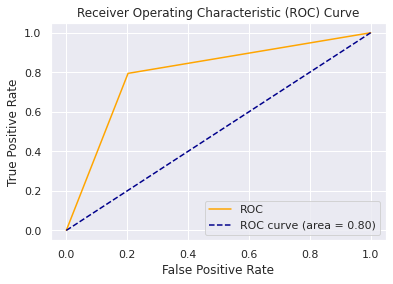

In [142]:
plt.plot(fpr, tpr, color='orange', label='ROC')
plt.plot([0, 1], [0, 1], color='darkblue', linestyle='--',label='ROC curve (area = %0.2f)' % auc)
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend()
plt.show()

[0.         0.         0.00263026 ... 0.99987475 1.         1.        ]
[0.00000000e+00 1.25234815e-04 1.25234815e-04 ... 9.40889167e-01
 9.40889167e-01 1.00000000e+00]
[1.99999996 0.99999996 0.99998238 ... 0.0327773  0.03272924 0.00418261]
0.8738893566720165
Threshold value is: 0.44319086672835173


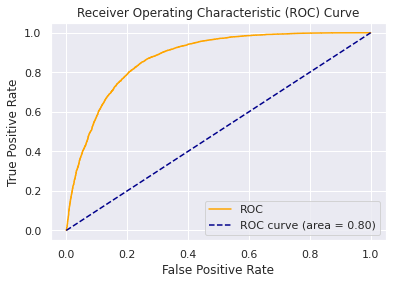

In [143]:
def plot_roc_curve(fpr, tpr):
    plt.plot(fpr, tpr, color='orange', label='ROC')
    plt.plot([0, 1], [0, 1], color='darkblue', linestyle='--',label='ROC curve (area = %0.2f)' % auc)
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver Operating Characteristic (ROC) Curve')
    plt.legend()
    plt.show()

fpr, tpr, thresholds = roc_curve(y_test2, log_reg.predict_proba(X_test3)[:,1])
print(tpr)
print(fpr)
print(thresholds)
print(roc_auc_score(y_test2,log_reg.predict_proba(X_test3)[:,1]))
optimal_idx = np.argmax(tpr - fpr)
optimal_threshold = thresholds[optimal_idx]
print("Threshold value is:", optimal_threshold)
plot_roc_curve(fpr, tpr)

## KNN

In [144]:
knn = KNeighborsClassifier(n_neighbors=10)
knn.fit(X_train3, y_train2)

KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='minkowski',
                     metric_params=None, n_jobs=None, n_neighbors=10, p=2,
                     weights='uniform')

In [145]:
y_pred = knn.predict(X_test3)

In [146]:
print("The accuracy score is : ", accuracy_score(y_test2,y_pred))

The accuracy score is :  0.8629845325317803


In [147]:
print(classification_report(y_test2,y_pred))

              precision    recall  f1-score   support

           0       0.83      0.91      0.87      7985
           1       0.90      0.81      0.86      7984

    accuracy                           0.86     15969
   macro avg       0.87      0.86      0.86     15969
weighted avg       0.87      0.86      0.86     15969



In [148]:
# Area Under Curvefrom sklearn.metrics import roc_auc_score
from sklearn.metrics import roc_auc_score
auc = roc_auc_score(y_test2, y_pred)
auc

0.8629814183783974

In [149]:
from sklearn.metrics import roc_curve
fpr,tpr,threshold=roc_curve(y_test2, y_pred)
threshold

array([2, 1, 0])

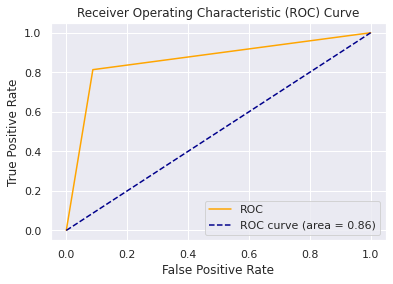

In [150]:
plt.plot(fpr, tpr, color='orange', label='ROC')
plt.plot([0, 1], [0, 1], color='darkblue', linestyle='--',label='ROC curve (area = %0.2f)' % auc)
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend()
plt.show()

## DecisionTreeClassifier

In [151]:
from sklearn.tree import DecisionTreeClassifier
dt=DecisionTreeClassifier()
dt.fit(X_train3, y_train2)
y_hat=dt.predict(X_test3)

In [152]:
## test acc
test_acc=accuracy_score(y_test2,y_hat)
test_acc

0.9205335337215855

In [153]:
print(classification_report(y_test2,y_hat))

              precision    recall  f1-score   support

           0       0.92      0.92      0.92      7985
           1       0.92      0.92      0.92      7984

    accuracy                           0.92     15969
   macro avg       0.92      0.92      0.92     15969
weighted avg       0.92      0.92      0.92     15969



## GridSearchCV:
This function helps to loop through predefined hyperparameters and fit your estimator (model) on your training set.

In [154]:
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV

In [155]:
parameters = {'max_depth':range(1,10),
              'min_samples_split': range(1,10),
              'min_samples_leaf': range(1,10)
             }  
grid = GridSearchCV(dt,parameters,cv=10,verbose=1,n_jobs=-1)
grid.fit(X_train3,y_train2)

Fitting 10 folds for each of 729 candidates, totalling 7290 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  76 tasks      | elapsed:    4.1s
[Parallel(n_jobs=-1)]: Done 648 tasks      | elapsed:   27.0s
[Parallel(n_jobs=-1)]: Done 1648 tasks      | elapsed:  1.5min
[Parallel(n_jobs=-1)]: Done 2724 tasks      | elapsed:  3.5min
[Parallel(n_jobs=-1)]: Done 3624 tasks      | elapsed:  5.6min
[Parallel(n_jobs=-1)]: Done 4724 tasks      | elapsed:  8.5min
[Parallel(n_jobs=-1)]: Done 6024 tasks      | elapsed: 12.5min
[Parallel(n_jobs=-1)]: Done 7284 tasks      | elapsed: 16.9min
[Parallel(n_jobs=-1)]: Done 7287 out of 7290 | elapsed: 16.9min remaining:    0.4s
[Parallel(n_jobs=-1)]: Done 7290 out of 7290 | elapsed: 17.0min finished


GridSearchCV(cv=10, error_score=nan,
             estimator=DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None,
                                              criterion='gini', max_depth=None,
                                              max_features=None,
                                              max_leaf_nodes=None,
                                              min_impurity_decrease=0.0,
                                              min_impurity_split=None,
                                              min_samples_leaf=1,
                                              min_samples_split=2,
                                              min_weight_fraction_leaf=0.0,
                                              presort='deprecated',
                                              random_state=None,
                                              splitter='best'),
             iid='deprecated', n_jobs=-1,
             param_grid={'max_depth': range(1, 10),
                         'm

In [156]:
print(grid.best_score_)
print(grid.best_params_)  

0.903577243675245
{'max_depth': 9, 'min_samples_leaf': 2, 'min_samples_split': 5}


In [157]:
tr_model = DecisionTreeClassifier(max_depth= 9, min_samples_leaf= 3, min_samples_split= 7)

In [158]:
tr_model.fit(X_train3,y_train2)

DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='gini',
                       max_depth=9, max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=3, min_samples_split=7,
                       min_weight_fraction_leaf=0.0, presort='deprecated',
                       random_state=None, splitter='best')

In [159]:
y_pred_tr= tr_model.predict(X_test3)

In [160]:
print(classification_report(y_test2, y_pred_tr))

              precision    recall  f1-score   support

           0       0.90      0.91      0.91      7985
           1       0.91      0.90      0.91      7984

    accuracy                           0.91     15969
   macro avg       0.91      0.91      0.91     15969
weighted avg       0.91      0.91      0.91     15969



## RandomForest

In [161]:
from sklearn.ensemble import RandomForestClassifier

In [162]:
rfc_model=RandomForestClassifier( n_estimators=8, max_depth=3, random_state=42) #default parameters

In [163]:
rfc_model.fit(X_train3,y_train2)

RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=3, max_features='auto',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=8,
                       n_jobs=None, oob_score=False, random_state=42, verbose=0,
                       warm_start=False)

In [164]:
y_pred_rfc= rfc_model.predict(X_test3)

In [165]:
print(classification_report(y_test2,y_pred_rfc))

              precision    recall  f1-score   support

           0       0.86      0.80      0.83      7985
           1       0.82      0.87      0.84      7984

    accuracy                           0.84     15969
   macro avg       0.84      0.84      0.84     15969
weighted avg       0.84      0.84      0.84     15969



# **.** After managing the imbalancing the target column and scaling the columns, we are getting the highest accuracy using Random Forest and Decision Models.

# **.**It means that the models will predict 88% correctly the customers who will subscribe term deposit.

# **.**These models will perfrom well as compared to imbalanced class models.

#### Column Names

In [166]:
X_train.columns

Index(['age', 'job', 'marital', 'education', 'default', 'balance', 'housing',
       'loan', 'contact', 'day', 'month', 'duration', 'campaign', 'pdays',
       'previous', 'poutcome'],
      dtype='object')

## Feature Importance:

##### Another great quality of random forest is that they make it very easy to measure the relative importance of each feature. Sklearn measure a features importance by looking at how much the treee nodes, that use that feature, reduce impurity on average (across all trees in the forest). It computes this score automaticall for each feature after training and scales the results so that the sum of all importances is equal to 1. We will acces this below:

In [167]:
importances = pd.DataFrame({'feature':X_train.columns,'importance':np.round(rfc_model.feature_importances_,3)})
importances = importances.sort_values('importance',ascending=False).set_index('feature')

In [168]:
X_train.columns

Index(['age', 'job', 'marital', 'education', 'default', 'balance', 'housing',
       'loan', 'contact', 'day', 'month', 'duration', 'campaign', 'pdays',
       'previous', 'poutcome'],
      dtype='object')

In [169]:
importances.head(17)

,importance
feature,
housing,0.227
contact,0.201
marital,0.194
duration,0.128
poutcome,0.067
pdays,0.053
job,0.050
month,0.031
previous,0.031


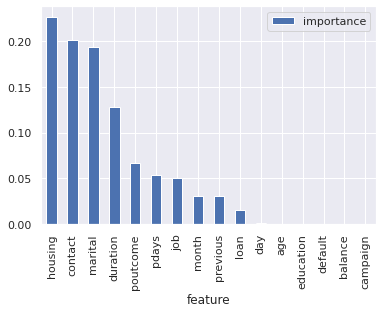

In [170]:
importances.plot.bar()

## Dropping some columns:

  A significant role in our random forest classifiers prediction process, because of that I will drop ('age','job','education','default','day','balance') them from the dataset and train the classifier again. We could also remove more or less features, but this would need a more detailed investigation of the features effect on our model. But I think it's just fine to remove them.

In [171]:
df_drop= df.drop(['age','job','education','default','day','balance'], axis=1)

In [172]:
df_drop

,marital,housing,loan,contact,month,duration,campaign,pdays,previous,poutcome,y
0,2,1,0,0,5,261,1.0,-1,0,0,0
1,1,1,0,0,5,151,1.0,-1,0,0,0
2,2,1,1,0,5,76,1.0,-1,0,0,0
3,2,1,0,0,5,92,1.0,-1,0,0,0
4,1,0,0,0,5,198,1.0,-1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...
45206,2,0,0,1,11,977,3.0,-1,0,0,1
45207,0,0,0,1,11,456,2.0,-1,0,0,1
45208,2,0,0,1,11,1127,5.0,184,3,1,1
45209,2,0,0,2,11,508,4.0,-1,0,0,0


## Spliting the data and Trianing the data

In [173]:
x1=df_drop.iloc[:,:-1]
y1=df_drop.iloc[:,-1]

In [174]:
from sklearn.model_selection import train_test_split
X_train3, X_test3, y_train3, y_test3 = train_test_split(x1, y1, test_size=0.20, random_state=42, stratify=y1)

In [175]:
y_train3.shape, y_test3.shape

((36168,), (9043,))

In [176]:
y_train3.value_counts(), y_test3.value_counts()

(0    31937
 1     4231
 Name: y, dtype: int64, 0    7985
 1    1058
 Name: y, dtype: int64)

## Using of  SMOTE on Dropped data

In [177]:
smote_drop= SMOTE(sampling_strategy='minority')

In [178]:
x_sm_drop,y_sm_drop= smote_drop.fit_resample(x1,y1)


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function safe_indexing is deprecated; safe_indexing is deprecated in version 0.22 and will be removed in version 0.24.
  warnings.warn(msg, category=FutureWarning)


In [179]:
X_train3, X_test3, y_train3, y_test3 = train_test_split(x_sm_drop, y_sm_drop, test_size=0.20, random_state=42,stratify=y_sm_drop)

In [180]:
minmax_scalar=MinMaxScaler()
X_train4= minmax_scalar.fit_transform(X_train3)
X_test4= minmax_scalar.transform(X_test3)

### Random Forest

In [181]:
rfc_drop_model=RandomForestClassifier( n_estimators=8, max_depth=3, random_state=42) #default parameters=

In [182]:
rfc_drop_model.fit(X_train4,y_train3)

RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=3, max_features='auto',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=8,
                       n_jobs=None, oob_score=False, random_state=42, verbose=0,
                       warm_start=False)

In [183]:
y_pred_drop_rfc= rfc_drop_model.predict(X_test4)

In [184]:
pd.crosstab(y_test3,y_pred_drop_rfc)

col_0,0,1
row_0,,
0,6255,1730
1,899,7085


In [185]:
print(classification_report(y_test3,y_pred_drop_rfc))

              precision    recall  f1-score   support

           0       0.87      0.78      0.83      7985
           1       0.80      0.89      0.84      7984

    accuracy                           0.84     15969
   macro avg       0.84      0.84      0.83     15969
weighted avg       0.84      0.84      0.83     15969



Our random forest model predicts as good as it did before. A general rule is that, the more features you have, the more likely your model will suffer from overfitting and vice versa. But I think our data looks fine for now and hasn't too much features.

### LogisticRegression

In [186]:
model_drop_lr= LogisticRegression()

In [187]:
model_drop_lr.fit(X_train4,y_train3)

LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
                   intercept_scaling=1, l1_ratio=None, max_iter=100,
                   multi_class='auto', n_jobs=None, penalty='l2',
                   random_state=None, solver='lbfgs', tol=0.0001, verbose=0,
                   warm_start=False)

In [188]:
y_pred_drop_lr= model_drop_lr.predict(X_test4)

In [189]:
pd.crosstab(y_test3,y_pred_drop_lr)

col_0,0,1
row_0,,
0,6363,1622
1,1654,6330


In [190]:
print(classification_report(y_test3,y_pred_drop_lr))

              precision    recall  f1-score   support

           0       0.79      0.80      0.80      7985
           1       0.80      0.79      0.79      7984

    accuracy                           0.79     15969
   macro avg       0.79      0.79      0.79     15969
weighted avg       0.79      0.79      0.79     15969



### KNeighborsClassifier

In [191]:
model_drop_knn= KNeighborsClassifier()

In [192]:
model_drop_knn.fit(X_train4,y_train3)

KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='minkowski',
                     metric_params=None, n_jobs=None, n_neighbors=5, p=2,
                     weights='uniform')

In [193]:
y_pred_drop_knn= model_drop_knn.predict(X_test4)

In [194]:
pd.crosstab(y_test3,y_pred_drop_knn)

col_0,0,1
row_0,,
0,7443,542
1,760,7224


In [195]:
print(classification_report(y_test3,y_pred_drop_knn))

              precision    recall  f1-score   support

           0       0.91      0.93      0.92      7985
           1       0.93      0.90      0.92      7984

    accuracy                           0.92     15969
   macro avg       0.92      0.92      0.92     15969
weighted avg       0.92      0.92      0.92     15969



### DecisionTreeClassifier

In [196]:
from sklearn import tree
model_drop_dt= tree.DecisionTreeClassifier()

In [197]:
model_drop_dt.fit(X_train4,y_train3)

DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='gini',
                       max_depth=None, max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, presort='deprecated',
                       random_state=None, splitter='best')

In [198]:
y_pred_drop_dt= model_drop_dt.predict(X_test4)

In [199]:
pd.crosstab(y_test3,y_pred_drop_dt)

col_0,0,1
row_0,,
0,7408,577
1,589,7395


In [200]:
print(classification_report(y_test3,y_pred_drop_dt))

              precision    recall  f1-score   support

           0       0.93      0.93      0.93      7985
           1       0.93      0.93      0.93      7984

    accuracy                           0.93     15969
   macro avg       0.93      0.93      0.93     15969
weighted avg       0.93      0.93      0.93     15969



After dropping few columns on the basis of feature importance, we get here also good accuracy and recall values in the Decision tree and Random.


# **Conculsion:**

After performming some Machine Learning Classification Algorithms, we get 88% accuracy and Recall values. It means that the models will predict 88% correctly the customers who will subscribe term deposit.
